<a href="https://colab.research.google.com/github/Chebem/Artfiical-Intelligence-/blob/main/P05_PyTorch_Audio_Practice_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

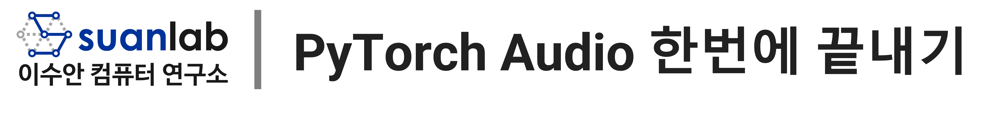

- 참고: Moto Hira, https://pytorch.org/tutorials/


# PyTorch Audio I/O

- TorchAudio를 이용한 기본 I/O API 사용
- 오디오 파일을 PyTorch 텐서에 로드하고 저장


2.6.0+cu124
2.6.0+cu124


## 라이브러리 설치 및 로드

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.9/139.9 kB 9.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.6/13.6 MB 120.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 84.8/84.8 kB 8.0 MB/s eta 0:00:00


## 데이터 준비

100%|██████████| 7.99k/7.99k [00:00<00:00, 14.8MB/s]
100%|██████████| 106k/106k [00:00<00:00, 38.5MB/s]
100%|██████████| 53.2k/53.2k [00:00<00:00, 65.7MB/s]


## 오디오 메타데이터

- `torchaudio.info`는 오디오 메타데이터를 불러옴
- 경로형 객체나 파일형 객체를 제공

AudioMetaData(sample_rate=16000, num_frames=54400, num_channels=1, bits_per_sample=16, encoding=PCM_S)


- ``sample_rate``: 오디오의 샘플링 속도
- ``num_channels``: 채널 수
- ``num_frames``: 채널당 프레임 수, GSM-FR 형식의 경우 0
- ``bits_per_sample``: 샘플의 비트, 압축 및/또는 가변 비트 전송률(예: MP3)이 있는 형식의 경우 0
- ``encoding``: 인코딩 형식
  -  ``"PCM_S"``: Signed integer linear PCM
  -  ``"PCM_U"``: Unsigned integer linear PCM
  -  ``"PCM_F"``: Floating point linear PCM
  -  ``"FLAC"``: Flac, [Free Lossless Audio
    Codec](https://xiph.org/flac/)
  -  ``"ULAW"``: Mu-law,
    [[wikipedia](https://en.wikipedia.org/wiki/%CE%9C-law_algorithm)]
  -  ``"ALAW"``: A-law
    [[wikipedia](https://en.wikipedia.org/wiki/A-law_algorithm)]
  -  ``"MP3"`` : MP3, MPEG-1 Audio Layer III
  -  ``"VORBIS"``: OGG Vorbis [[xiph.org](https://xiph.org/vorbis/)]
  -  ``"AMR_NB"``: Adaptive Multi-Rate
    [[wikipedia](https://en.wikipedia.org/wiki/Adaptive_Multi-Rate_audio_codec)]
  -  ``"AMR_WB"``: Adaptive Multi-Rate Wideband
    [[wikipedia](https://en.wikipedia.org/wiki/Adaptive_Multi-Rate_Wideband)]
  -  ``"OPUS"``: Opus [[opus-codec.org](https://opus-codec.org/)]
  -  ``"GSM"``: GSM-FR
    [[wikipedia](https://en.wikipedia.org/wiki/Full_Rate)]
  -  ``"HTK"``: Single channel 16-bit PCM
  -  ``"UNKNOWN"`` None of above


AudioMetaData(sample_rate=8000, num_frames=39680, num_channels=1, bits_per_sample=0, encoding=GSM)


## 파일형 객체 메타데이터

`torchaudio.info` 함수는 파일형 객체에 대해서도 동작




AudioMetaData(sample_rate=44100, num_frames=109368, num_channels=2, bits_per_sample=16, encoding=PCM_S)


- 파일형 객체를 전달할 때, `info()`함수는 모든 데이터를 읽는 것이 아니라 데이터의 처음 일부만 읽음
- 주어진 오디오에 대해 형식 자체를 포함하여 올바른 메타데이터를 검색하지 못할 수 있음
- 이러한 경우, `format` 인수를 통해 오디오의 형식을 지정할 수 있음

## 오디오 데이터 로드

- `torchaudio.load` 사용하여 오디오 데이터 로드
- 경로형 개체(path-like object) 또는 파일형 개체(file-like object)를 입력으로 받음
- 반환되는 값은 파형(`Tensor`)과 샘플 속도(`int`)의 튜플
- 기본적으로 결과 텐서 개체는 `dtype=torch.float32`이고 값 범위는 `[-1.0, 1.0]`
- 지원 형식 목록 참고: https://pytorch.org/audio

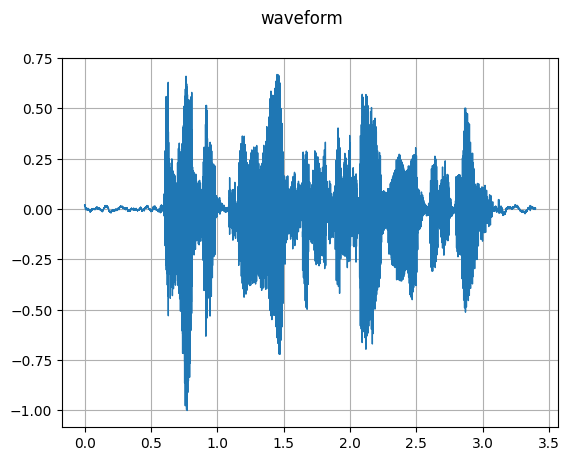

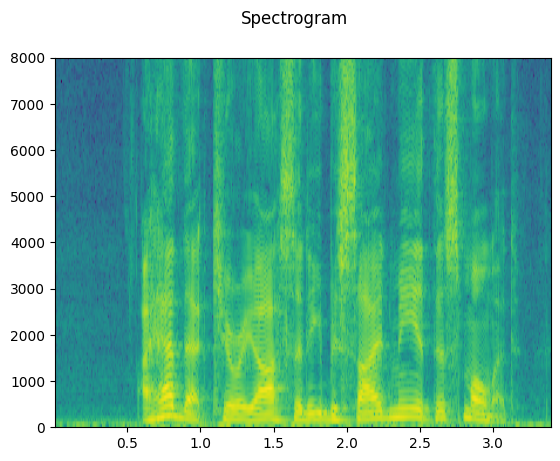

## 파일형 객체 데이터 로드

- I/O 함수는 파일형 객체 지원
- 로컬 파일 시스템 위치에서 오디오 데이터를 가져오고 디코딩 가능

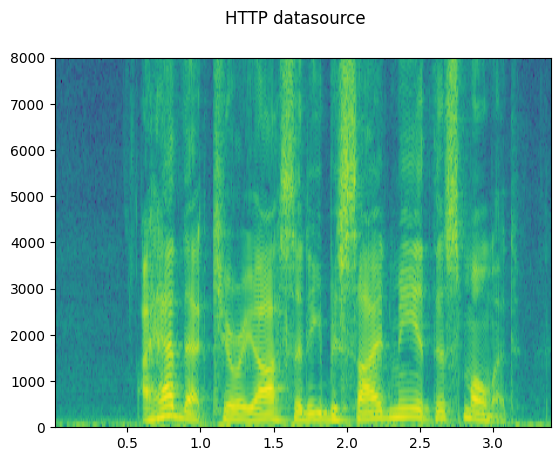

100%|██████████| 110k/110k [00:01<00:00, 59.9kB/s]


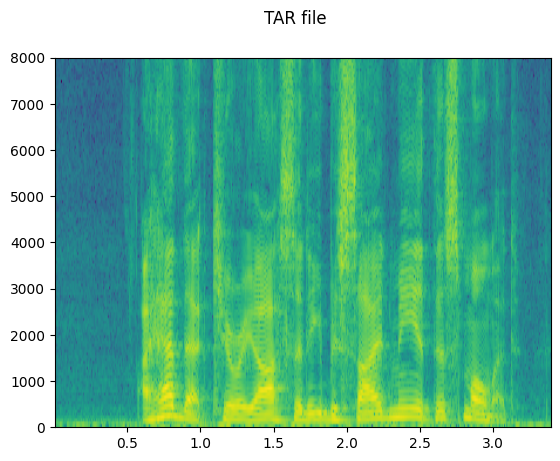

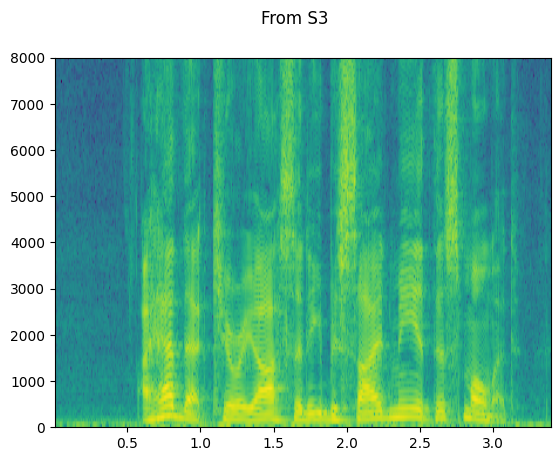

## 슬라이싱(slicing)

- 디코딩을 `num_frames`와 `frame_offset`을 통해 입력의 해당 세그먼트로 제한하는 기능 제공
- 기본 텐서 슬라이싱(`waveform[:, frame_offset:frame_offset+num_frames]`)을 사용해도 동일한 결과
- 요청된 프레임의 디코딩이 완료되면 함수가 데이터 수집과 디코딩을 종료하기 때문에 `num_frames`와 `frame_offset` 인수를 제공하는 것이 더 효율적
- 네트워크를 통해 오디오 데이터를 전송할 때 필요한 양의 데이터를 가져오는 즉시 데이터 전송이 중단되므로 유리

Fetching all the data...
 - Fetched 108844 bytes
Fetching until the requested frames are available...
 - Fetched 108844 bytes
Checking the resulting waveform ... matched!


## 오디오를 파일로 저장

- 일반적인 애플리케이션에서 해석 가능한 형식으로 오디오 데이터를 저장하려면 `torchaudio.save` 사용
- 이 함수는 경로형 개체 또는 파일형 개체를 받음
- 파일형 개체를 전달할 때는 함수가 어떤 형식을 사용할지 알 수 있도록 인자 `format`도 제공해야 함
- 경로형 객체의 경우, 확장자에서 형식을 유추하며, 확장자가 없는 파일에 저장하는 경우 인자 형식을 제공해야 함
- WAV 형식의 데이터를 저장할 때, `float32` Tensor의 기본 인코딩은 32비트 부동 소수점 PCM
- 이 동작을 변경하려면 인자 `encoding` 및 `bits_per_sample`을 제공할 수 있음
- bit depth를 낮은 인코딩으로 데이터를 저장하면 결과 파일 크기뿐만 아니라 정밀도도 감소

인코딩 옵션 없이 저장하면, 함수에서 제공된 데이터에 맞는 인코딩을 선택

----------
Source: /tmp/tmpo4vazj1k/save_example_default.wav
----------
 - File size: 108878 bytes
 - AudioMetaData(sample_rate=16000, num_frames=54400, num_channels=1, bits_per_sample=16, encoding=PCM_S)



16비트 부호 있는 정수 선형 PCM으로 저장하면, 절반의 공간만 차지하지만 정밀도가 떨어짐

----------
Source: /tmp/tmpavfzu4oq/save_example_PCM_S16.wav
----------
 - File size: 108878 bytes
 - AudioMetaData(sample_rate=16000, num_frames=54400, num_channels=1, bits_per_sample=16, encoding=PCM_S)



- `torchaudio.save`는 다른 여러 포맷들도 처리 가능




----------
Source: /tmp/tmp6r9apl3s/save_example.flac
----------
 - File size: 45264 bytes
 - AudioMetaData(sample_rate=8000, num_frames=27200, num_channels=1, bits_per_sample=16, encoding=FLAC)



## 파일형 객체에 저장

- 다른 I/O 함수와 마찬가지로 오디오를 파일형 객체에 저장 가능
- 파일형 객체에 저장할 때는 인수 `format` 지정이 필요



b'RIFFF\xa9\x01\x00WAVEfmt '


# 오디오 리샘플링 (Audio Resampling)

- PyTorch Audio를 이용한 리샘플링

2.6.0+cu124
2.6.0+cu124


## 라이브러리 설치 및 로드

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 66.5 MB/s eta 0:00:00


## 리샘플링 (Resampling)

- 오디오 파형을 한 주파수에서 다른 주파수로 리샘플링하려면, `torchaudio.transforms.Resample` 또는 `torchaudio.functional.resample`을 사용
- `transforms.Resample`은 리샘플링에 사용되는 커널을 미리 계산하고 캐시에 저장하는 반면, `functional.resample`은 즉석에서 계산하므로, 동일한 파라미터를 사용하여 여러 파형을 리샘플링할 때 `torchaudio.transforms.Resample`을 사용하면 속도가 빨라짐
- 두 리샘플링 방법 모두 [bandlimited sinc
interpolation](https://ccrma.stanford.edu/~jos/resample/)을 사용하여 임의의 시간 단계에서 신호 값을 계산, 구현에는 컨볼루션이 포함되므로 성능 향상을 위해 GPU/멀티스레딩 활용 가능
- 여러 작업자 프로세스가 있는 데이터 로딩과 같이 여러 하위 프로세스에서 리샘플링을 사용하는 경우 애플리케이션에서 시스템이 효율적으로 처리할 수 있는 것보다 많은 스레드를 생성 가능, `torch.set_num_threads(1)`을 설정하면 도움
- 한정된 수의 샘플은 한정된 수의 주파수만 표현할 수 있기 때문에 리샘플링을 해도 완벽한 결과를 얻을 수 없으며, 다양한 파라미터를 사용하여 품질과 계산 속도를 제어할 수 있음
- 시간이 지남에 따라 주파수가 기하급수적으로 증가하는 사인파인 로그 사인 스윕을 리샘플링하여 이러한 특성을 보여줌
- 다음 스펙트로그램은 신호의 주파수 표현을 보여주며, 여기서 X축은 원래 파형의 주파수(로그 스케일), Y축은 플롯된 파형의 주파수, 색상 강도는 진폭에 해당

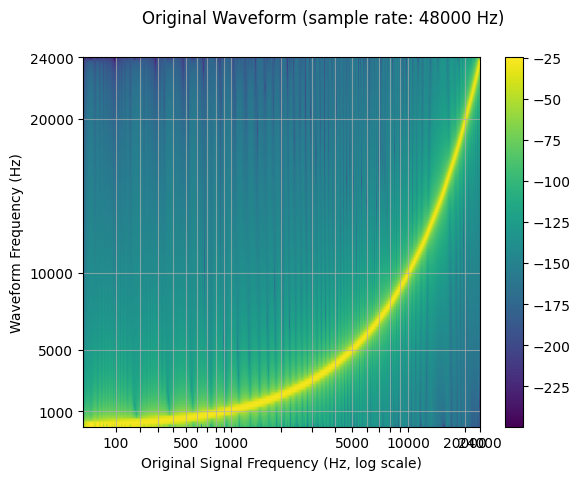

- 리샘플링(다운샘플링)된 파형의 스펙트로그램에서 원래 파형에는 없었던 아티팩트가 있음을 알 수 있음
- 이것을 에일리어싱(aliasing)이라고 하며, 에일리어싱이 어떻게 발생하는지, 왜 반사처럼 보이는지에 대한 설명은 [여기](https://music.arts.uci.edu/dobrian/digitalaudio.htm) 참고

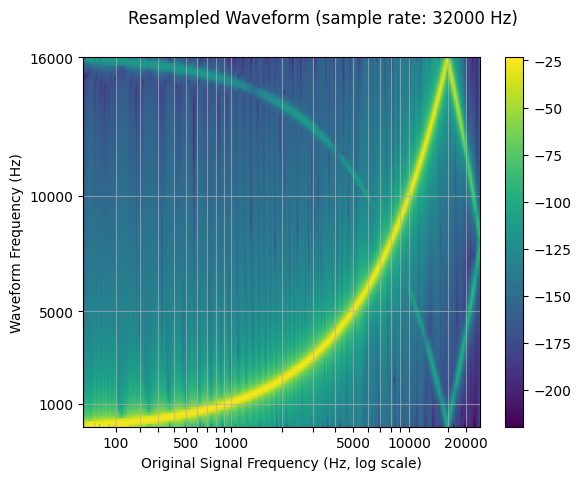

## 리샘플링 품질 제어

### 저역 통과 필터 너비 Lowpass filter width)

- 보간에 사용되는 필터는 무한히 확장되기 때문에 보간 윈도우에 사용할 필터의 너비를 제어하기 위해 `lowpass_filter_width` 파라미터 사용
- 보간이 모든 시간 단위에서 0을 통과하기 때문에 제로 크로싱 횟수라고도 함
- `lowpass_filter_width`를 크게 사용하면 더 선명하고 정밀한 필터가 제공되지만 계산 비용이 더 많이 필요

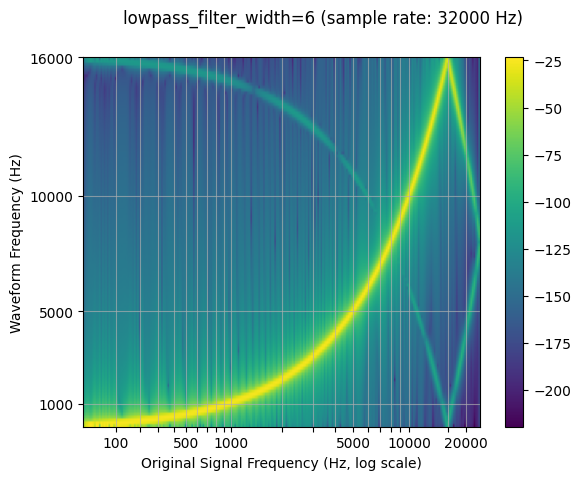

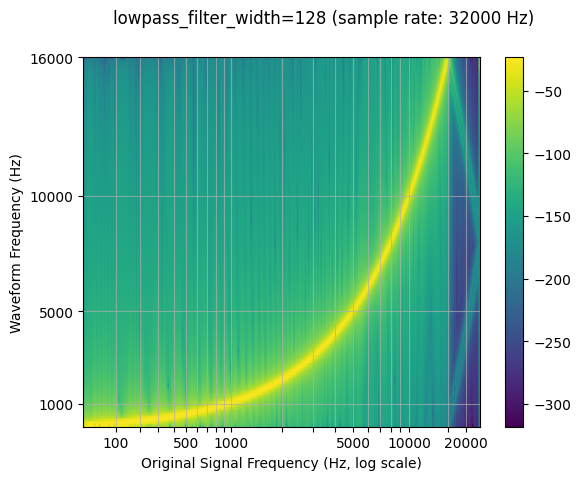

### 롤오프 (Rolloff)

- ``rolloff`` 매개변수는 주어진 유한 샘플 속도로 표현할 수 있는 최대 주파수인 나이퀴스트 주파수의 일부분으로 표시
- 롤오프는 로우패스 필터 차단을 결정하고 나이퀴스트보다 높은 주파수가 낮은 주파수에 매핑될 때 발생하는 에일리어싱의 정도를 제어
- 롤오프가 낮을수록 에일리어싱의 양이 줄어들지만 일부 높은 주파수도 감소

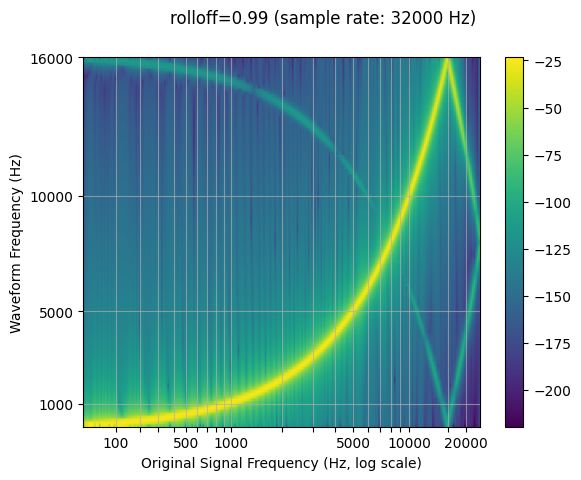

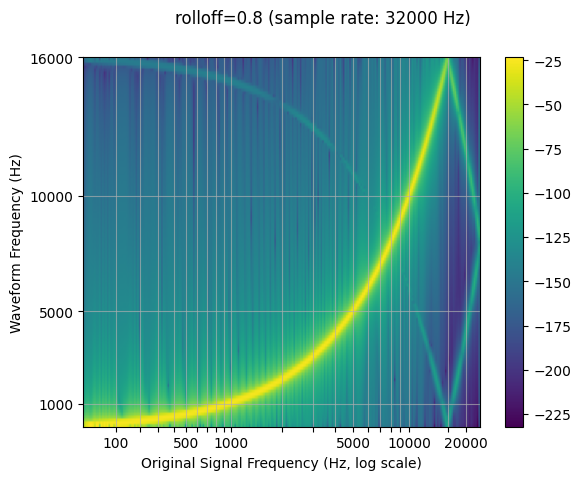

### 윈도우 함수 (Window function)

- 기본적으로 `torchaudio`의 리샘플은 가중 코사인 함수인 한 윈도우 필터를 사용
- 필터의 부드러움과 임펄스 폭을 설계할 수 있도록 추가로 `beta` 파라미터가 포함된 거의 최적의 윈도우 함수인 카이저 윈도우를 지원
- `resampling_method` 매개변수를 사용하여 제어 가능

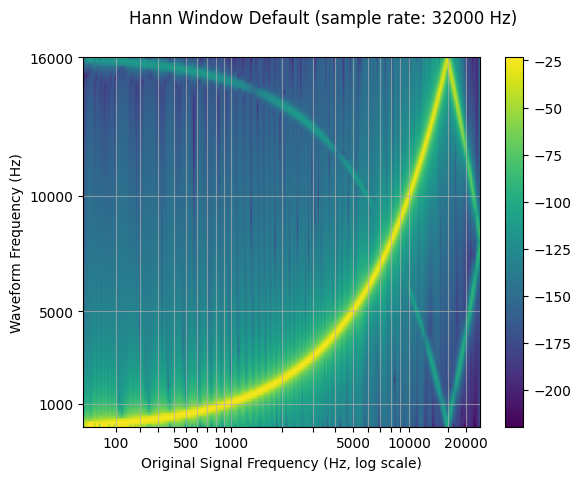

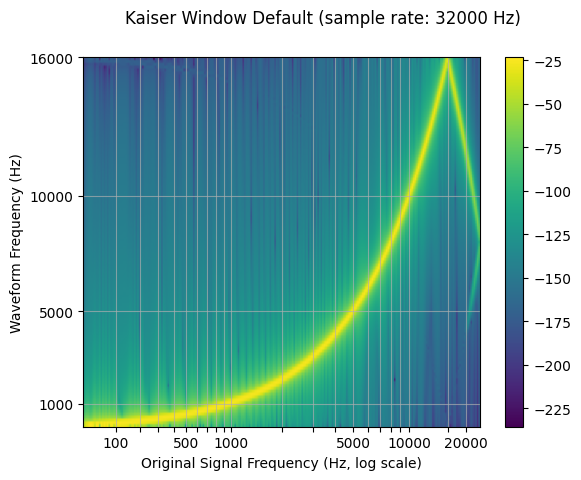

## `librosa`와 비교

- `torchaudio`의 리샘플링 기능과 비교하면, `librosa`(resampy)의 카이저 윈도우 리샘플링은 유사한 결과를 얻을 수 있지만 약간의 노이즈가 있음

### kaiser_best




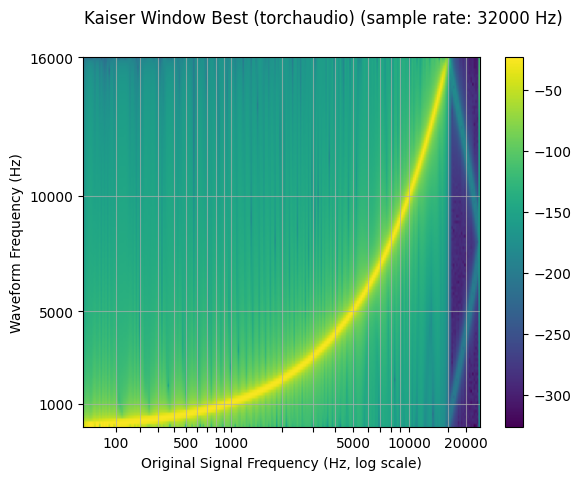

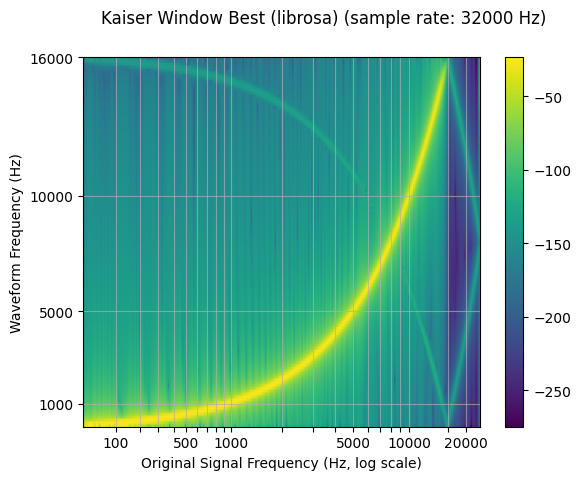

torchaudio and librosa kaiser best MSE: 0.0013004566355607605


### kaiser_fast




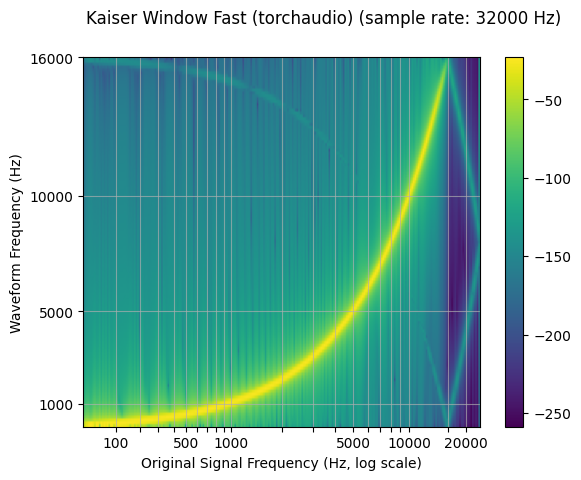

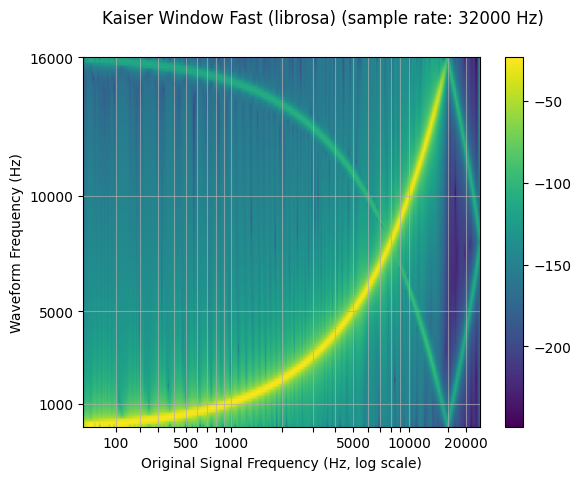

torchaudio and librosa kaiser fast MSE: 0.0002567981251853194


## 성능 벤치마킹 (Performance Benchmarking)

- 두 쌍의 샘플링 속도 사이의 다운샘플링 및 업샘플링 파형에 대한 벤치마크
- `lowpass_filter_width`, 윈도우 유형, 샘플 속도가 성능에 미칠 수 있는 영향을 보여줌
- `torchaudio`의 해당 파라미터를 사용하여 `librosa`의 `kaiser_best` 및 `kaiser_fast`와의 비교를 제공

torchaudio: 2.6.0+cu124
librosa: 0.11.0
resampy: 0.4.3


### Downsample (48 -> 44.1 kHz)



                 librosa  functional  transforms
sinc (width 64)      NaN       31.74        0.80
sinc (width 16)      NaN        1.55        0.74
kaiser_best        29.65        5.91        0.79
kaiser_fast         7.61        3.81        0.73


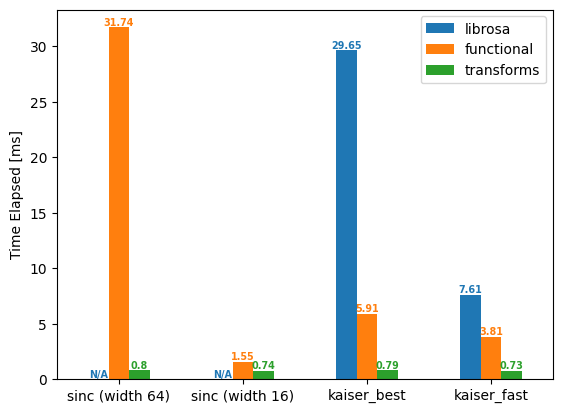

### Downsample (16 -> 8 kHz)



                 librosa  functional  transforms
sinc (width 64)      NaN        5.62        5.72
sinc (width 16)      NaN        2.74        1.40
kaiser_best        10.08        4.41        4.21
kaiser_fast         3.15        1.65        1.39


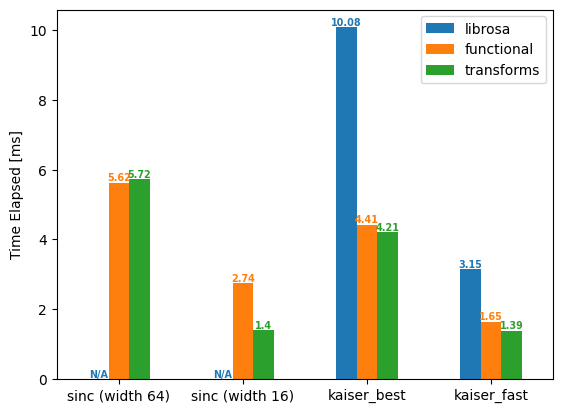

### Upsample (44.1 -> 48 kHz)



                 librosa  functional  transforms
sinc (width 64)      NaN        2.01        0.74
sinc (width 16)      NaN        1.49        0.60
kaiser_best        31.17        4.81        0.70
kaiser_fast         8.08        3.60        0.73


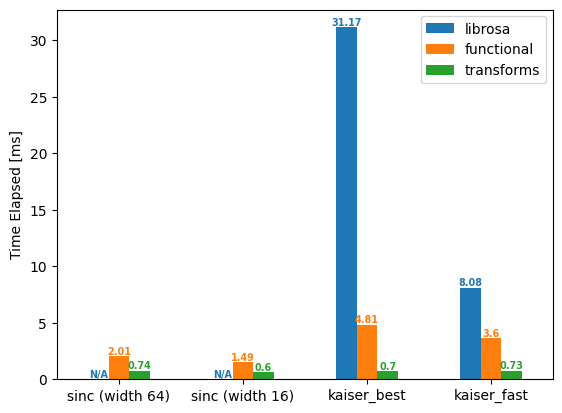

### Upsample (8 -> 16 kHz)



                 librosa  functional  transforms
sinc (width 64)      NaN        2.06        0.79
sinc (width 16)      NaN        0.55        0.33
kaiser_best        10.89        0.97        0.89
kaiser_fast         2.79        0.63        0.33


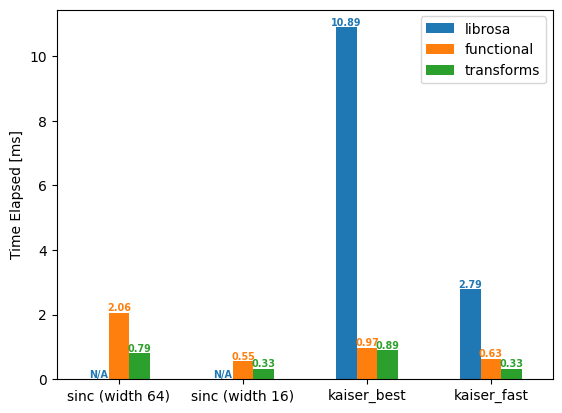

### 정리

- `lowpass_filter_width`가 클수록 리샘플링 커널이 커지므로 커널 계산과 컨볼루션의 계산 시간이 늘어남
- `sinc_interp_kaiser`를 사용하면 중간 윈도우 값을 계산하는 것이 더 복잡해지기 때문에 기본값인 sinc_interp_hann보다 계산 시간이 더 오래 걸림
- 샘플과 재샘플링 속도 사이의 GCD가 크면 커널이 더 작아지고 커널 계산이 빨라지는 단순화가 이루어짐

# 오디오 데이터 증강 (Audio Data Augmentation)

- `torchaudio`는 오디오 데이터를 보강하는 다양한 방법 제공
- 효과(effects), 필터(filters), RIR(room impulse response) 및 코덱(codecs) 적용 방법
- 깨끗한 음성에서 전화로 잡음이 있는 음성 합성

2.6.0+cu124
2.6.0+cu124


## 데이터셋 준비

100%|██████████| 427k/427k [00:00<00:00, 33.0MB/s]
100%|██████████| 31.3k/31.3k [00:00<00:00, 49.9kB/s]
100%|██████████| 78.2k/78.2k [00:00<00:00, 34.5MB/s]


## 이펙트와 필터 적용

- `torchaudio.io.AudioEffector`를 사용하면 ffmpeg 명령과 유사한 방식으로 텐서 객체에 필터와 코덱을 직접 적용 가능

torch.Size([109368, 2]) 44100
torch.Size([144642, 2]) 44100


- 효과 적용 후 프레임 수와 채널 수가 원본과 다르다는 점에 유의

### 원본




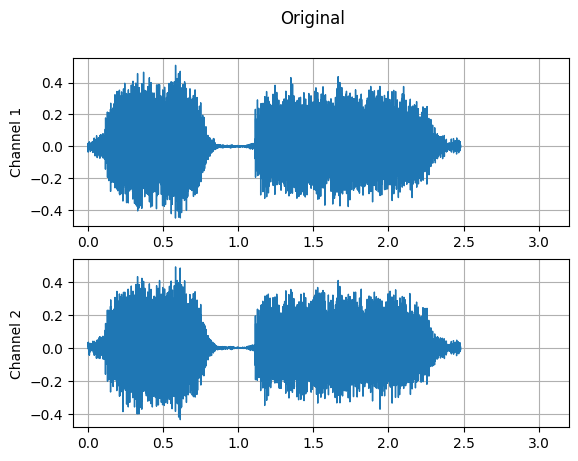

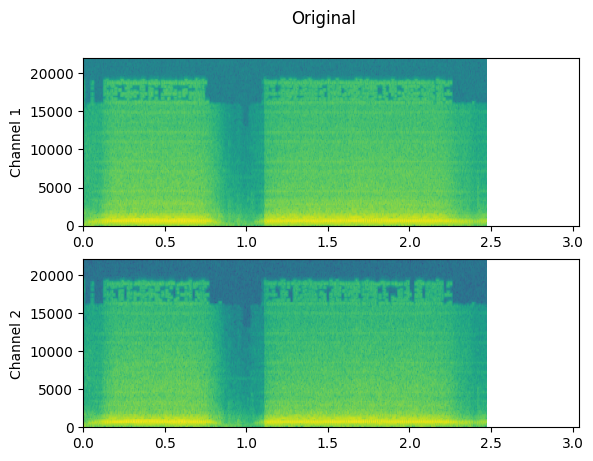

### 이펙트 적용




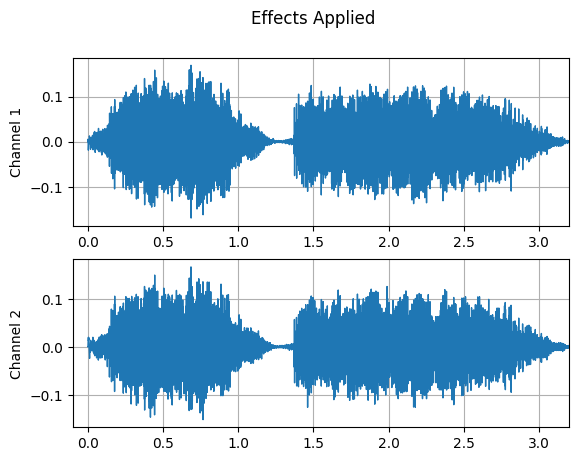

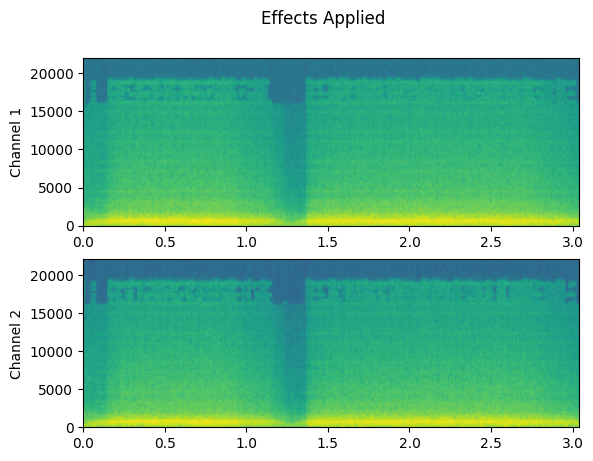

## 실내 잔향 (Room reverberation)

- [Convolution
reverb](https://en.wikipedia.org/wiki/Convolution_reverb)는 마치 다른 환경에서 녹음한 것처럼 깨끗한 오디오 사운드를 만드는 데 사용되는 기술
- Room Impulse Response (RIR)을 사용하면 회의실에서 발화한 것처럼 깨끗한 음성 사운드를 만들 수 있음, 이를 위해 RIR 데이터 필요
- 다음 데이터는 VOiCES 데이터 세트에서 가져온 것이지만 마이크를 켜고 손뼉을 치기만 하면 직접 녹음할 수 있음

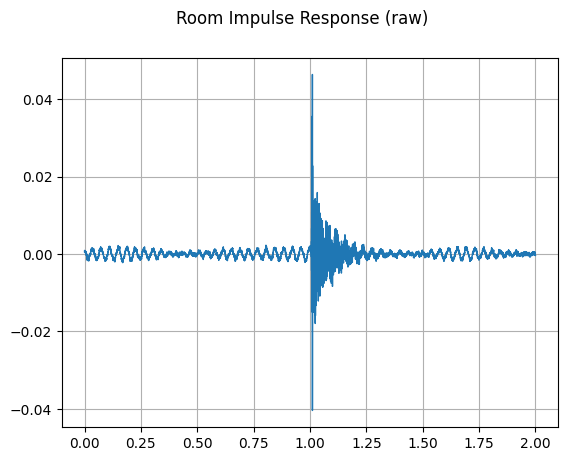

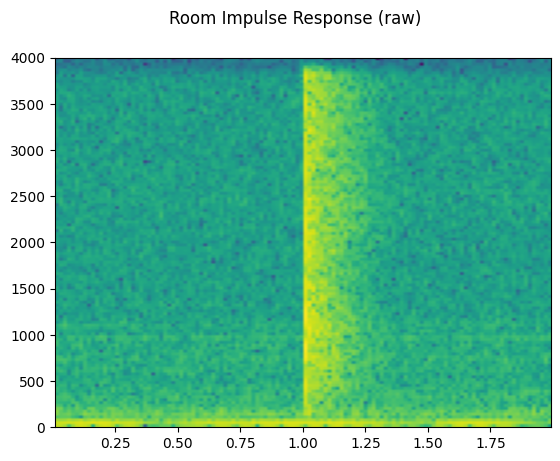

- RIR을 정리하기 위해 주 임펄스를 추출하고 그 힘에 따라 정규화




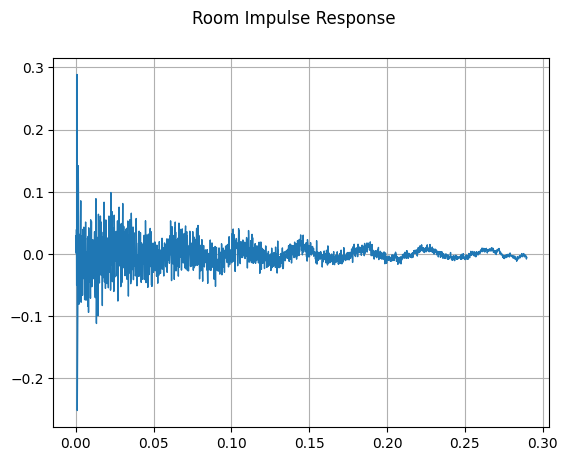

`torchaudio.functional.fftconvolve`를 사용하여 음성 신호를 RIR로 컨볼브(convolve)


### 원본




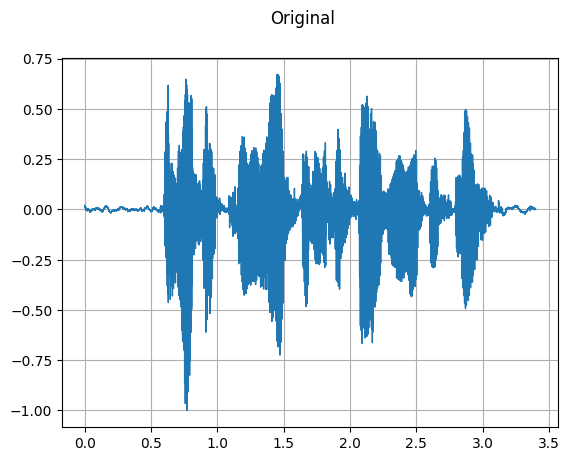

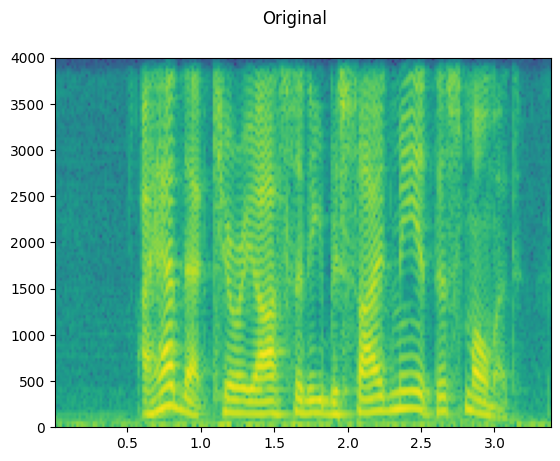

### RIR 적용




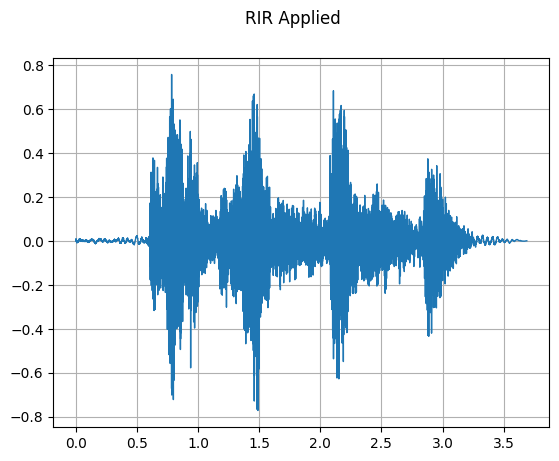

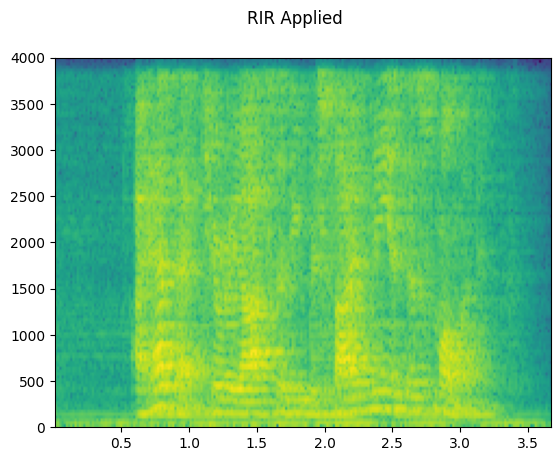

## 배경 소음 추가

- 오디오 데이터에 배경 노이즈를 도입하려면, 원하는 신호 대 잡음비(SNR)에 따라 오디오 데이터를 나타내는 텐서에 노이즈 텐서를 추가하여 출력의 노이즈 대비 오디오 데이터의 강도를 결정

$$ \mathrm{SNR} = \frac{P_{signal}}{P_{noise}} $$

$$ \mathrm{SNR_{dB}} = 10 \log _{{10}} \mathrm {SNR} $$

- SNR에 따라 오디오 데이터에 노이즈를 추가하려면 `torchaudio.functional.add_noise` 사용



### 배경 노이즈 (Background noise)




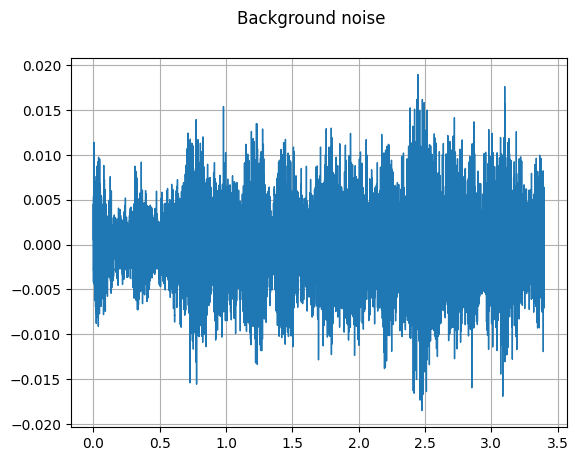

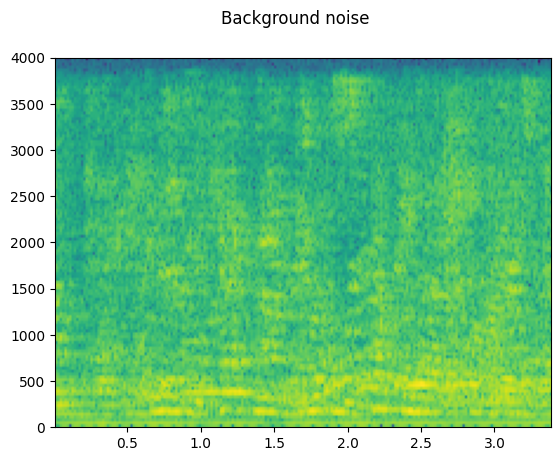

### SNR 20 dB




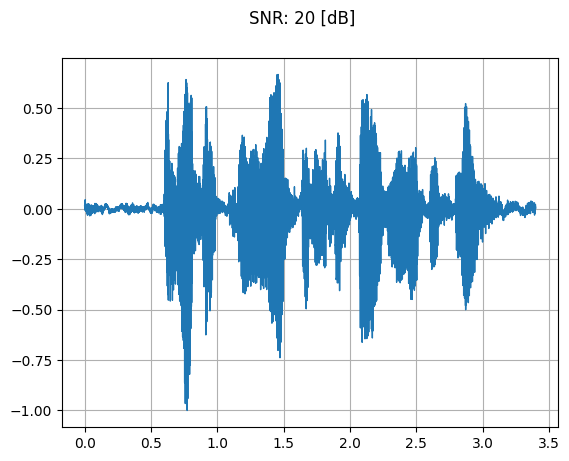

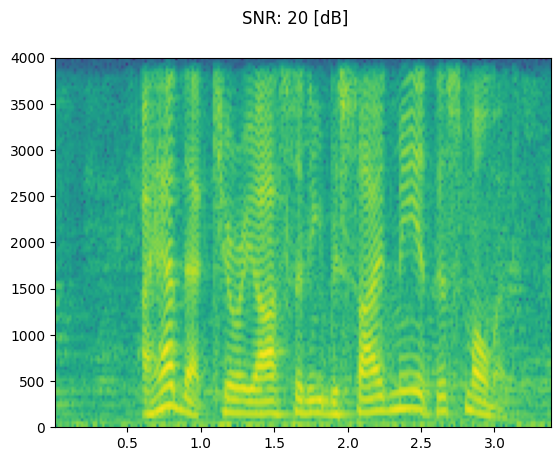

### SNR 10 dB




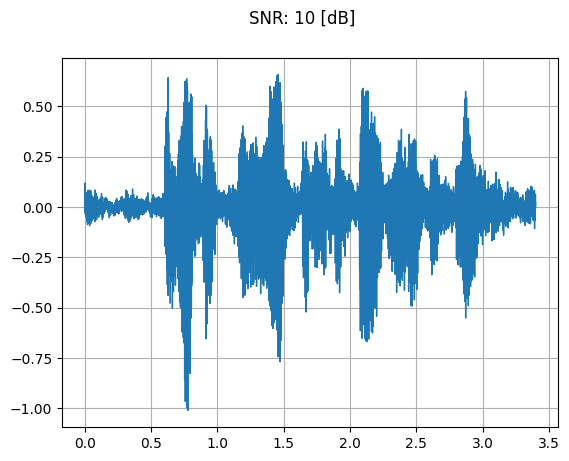

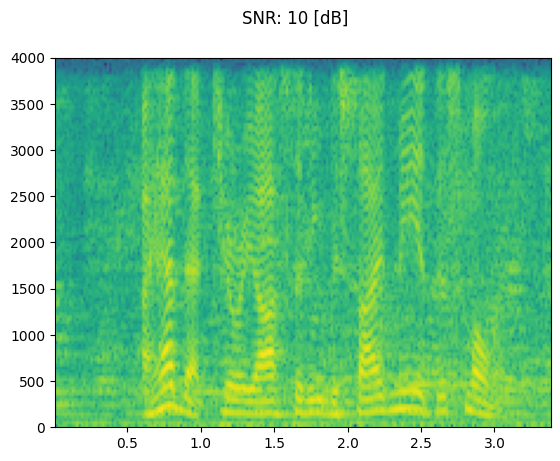

### SNR 3 dB




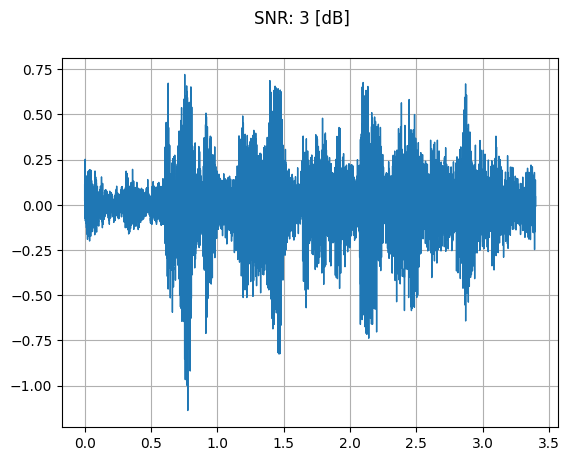

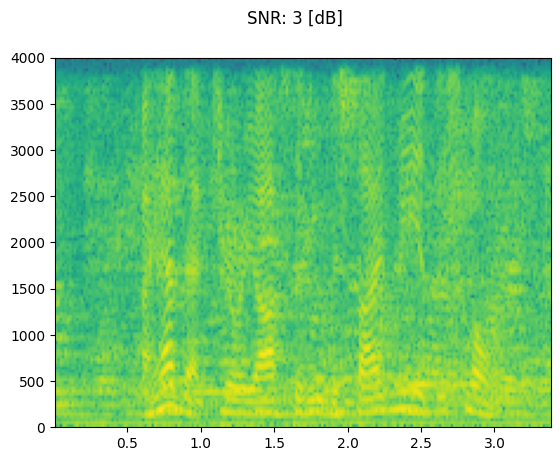

##  코덱 적용

`torchaudio.io.AudioEffector`를 사용하면 텐서 오브젝트에 코덱 적용 가능



### 원본




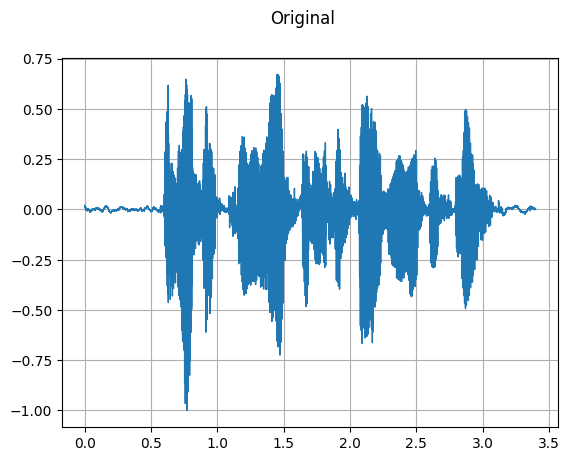

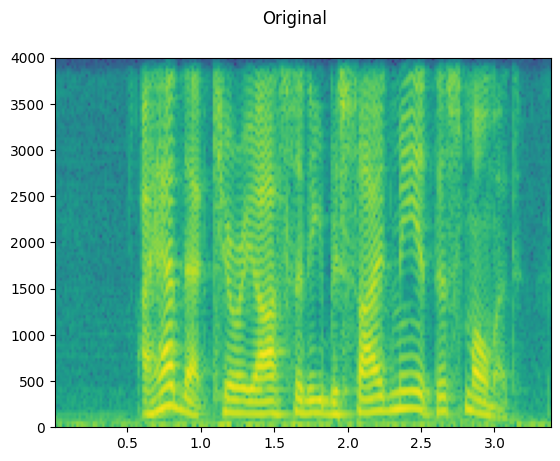

### 8 bit mu-law




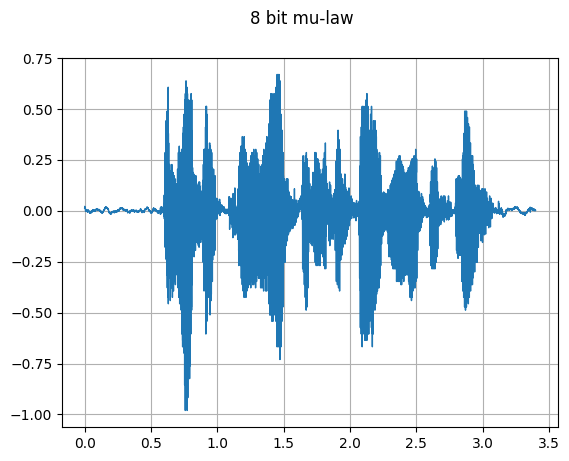

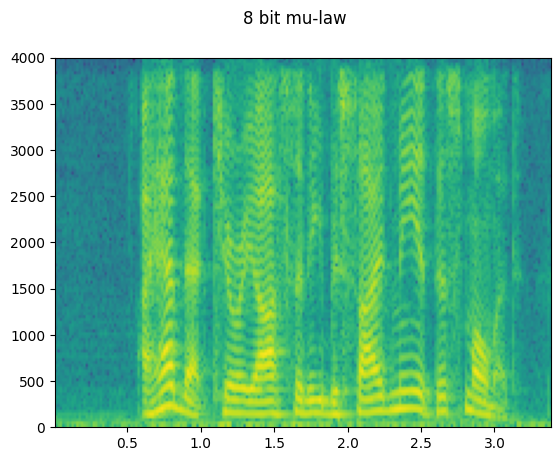

### G.722




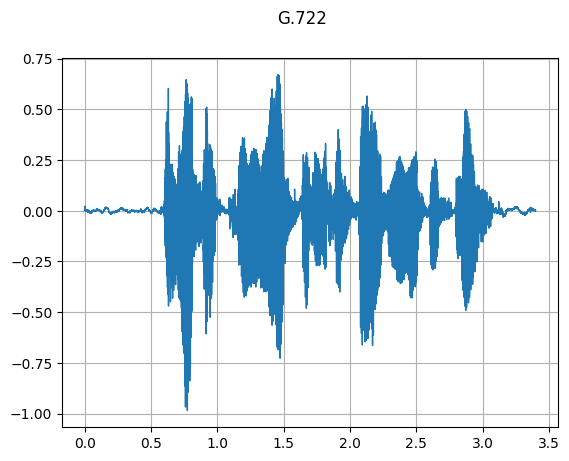

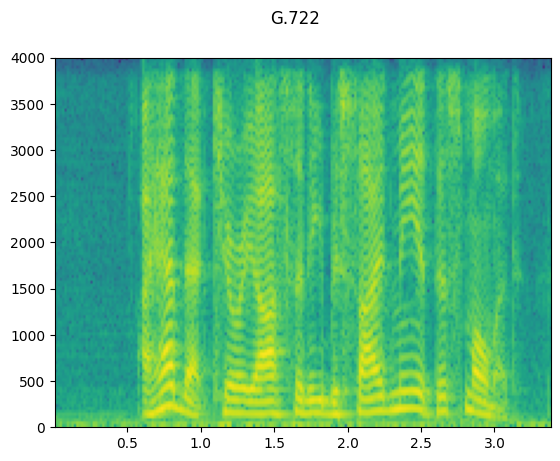

### Vorbis




/usr/local/lib/python3.11/dist-packages/matplotlib/axes/_axes.py:8233: RuntimeWarning: divide by zero encountered in log10
  Z = 10. * np.log10(spec)


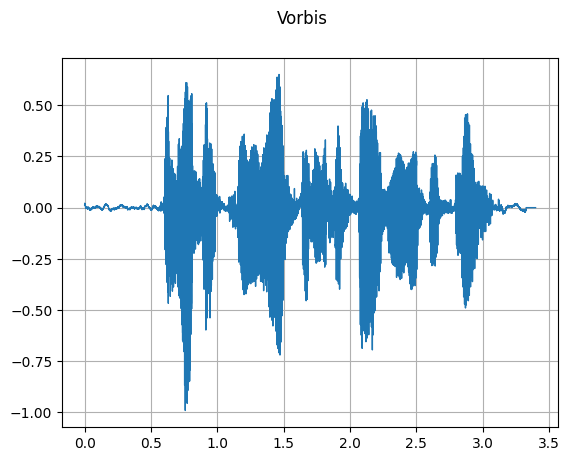

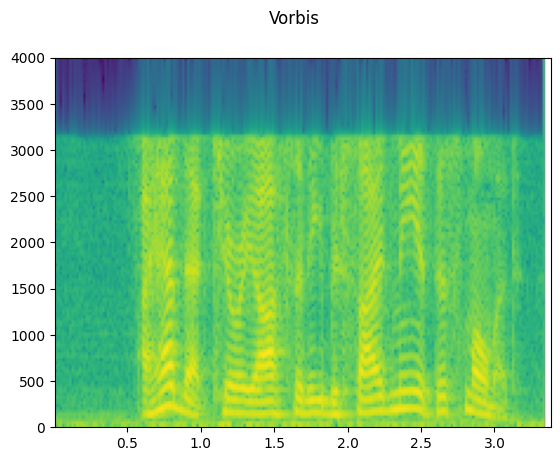

## 전화 녹음

- 앞의 기술을 결합하면 울리는 방에서 사람이 전화로 대화하는 것처럼 들리는 오디오를 배경에서 사람들이 대화하는 것처럼 시뮬레이션 가능


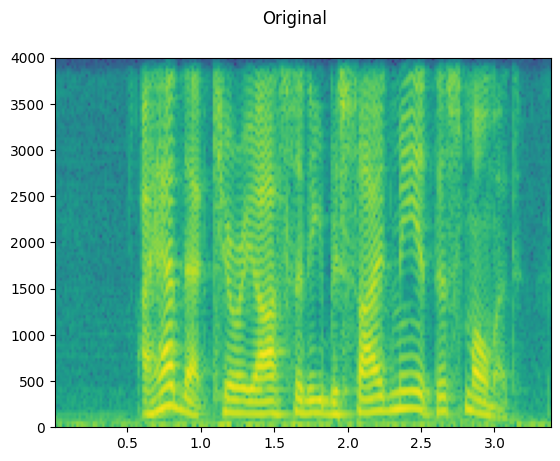

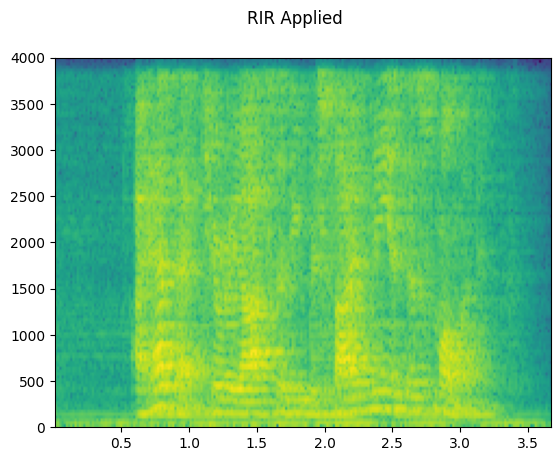

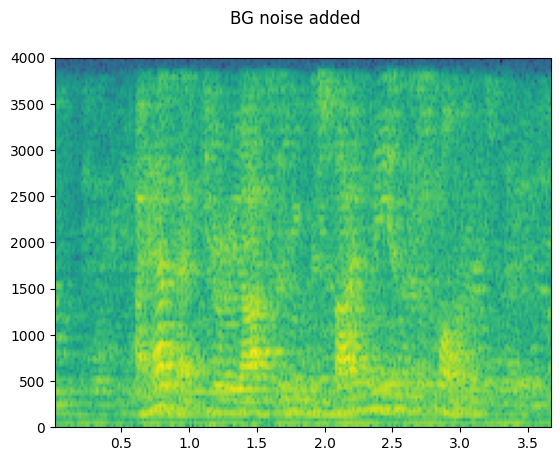

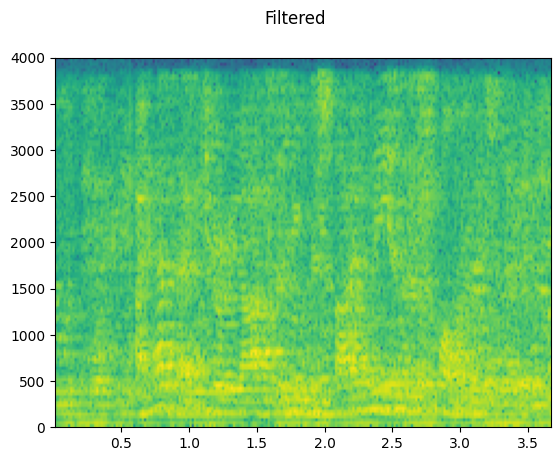

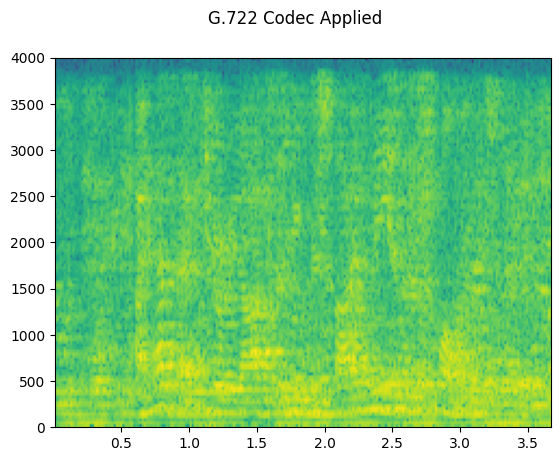

### 음성 원본




### RIR 적용




### 배경 노이즈 적용




### 필터 적용




### 코덱 적용




# 오디오 특징 추출 (Audio Feature Extractions)

- `torchaudio`는 오디오 도메인에서 일반적으로 사용되는 특징 추출 기능 구현
- `torchaudio.functional`과 `torchaudio.transforms`에서 사용 가능
- `functional`은 독립형 함수로 기능 구현
- `transforms`는 `functional` 및 `torch.nn.Module`의 구현을 사용하여 기능을 객체로 구현 (토치스크립트를 사용하여 직렬화 가능)

2.6.0+cu124
2.6.0+cu124


## 오디오 특징 구조

일반적인 오디오 특징과 이를 생성하기 위한 `torchaudio` API 간의 관계를 보여주는 다이어그램

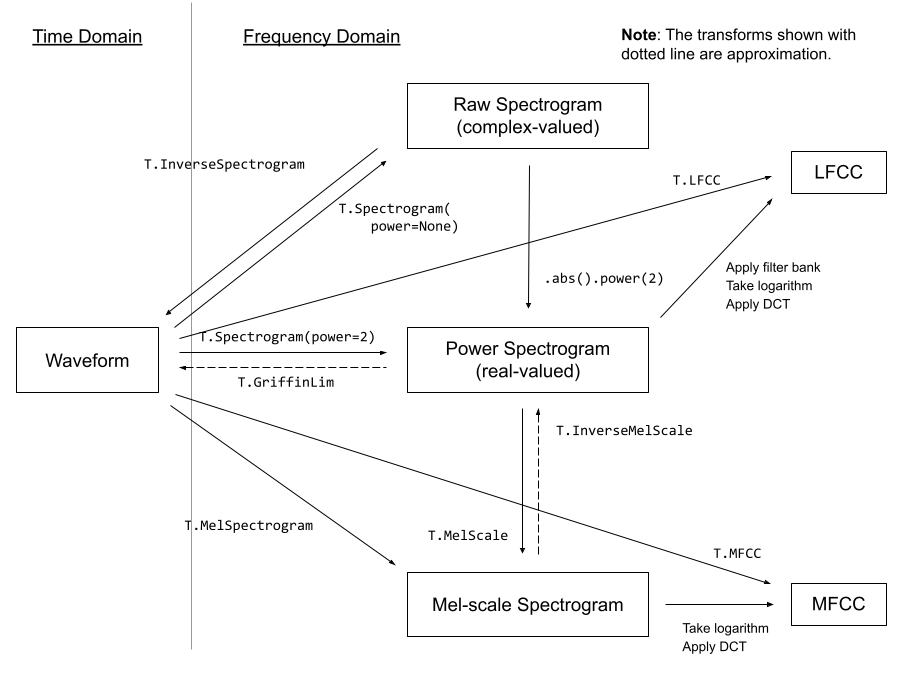

## 라이브러리 로드

## 스펙트로그램 (Spectrogram)

- 시간에 따라 변화하는 오디오 신호의 주파수 구성을 얻으려면 `torchaudio.transforms.Spectrogram` 사용

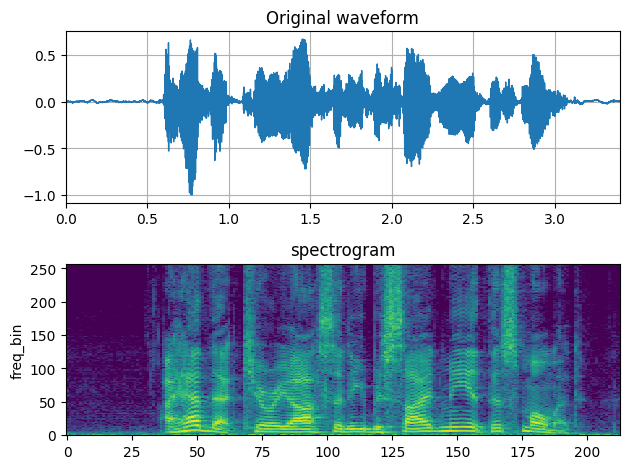

###  ``n_fft`` 파라미터의 효과

- 스펙트로그램 계산의 핵심은 (단기) 푸리에 변환이며, `n_fft`는 이산 푸리에 변환의 정의에서 N에 해당

$$ X_k = \sum_{n=0}^{N-1} x_n e^{-\frac{2\pi i}{N} nk} $$

- `n_fft` 값은 주파수 축의 해상도를 결정
- `n_fft` 값이 높을수록 에너지가 더 많은 빈에 분산되므로 시각화할 때 해상도가 높다고 생각해도 더 흐릿하게 보일 수 있음

- ``hop_length``는 시간축 해상도를 결정, 기본적으로 (즉, ``hop_length=None`` 및 ``win_length=None``인 경우) ``n_fft // 4`` 값이 사용
- 여기서는 시간 축에서 동일한 수의 엘리먼트를 갖도록 서로 다른 ``n_fft``에 동일한 ``hop_length`` 값을 사용

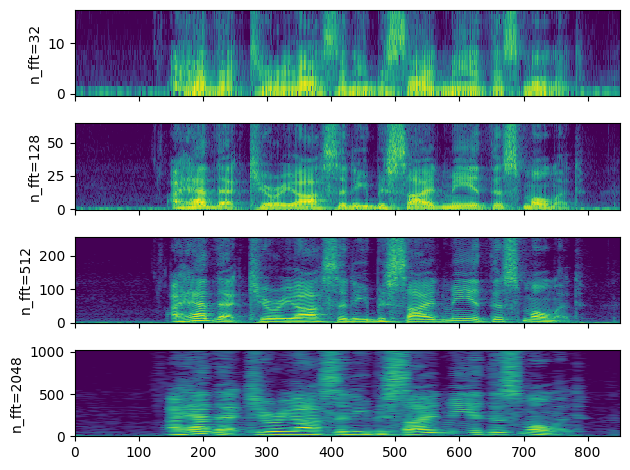

- 신호를 비교할 때는 동일한 샘플링 속도를 사용하는 것이 바람직하지만, 다른 샘플링 속도를 사용해야 하는 경우, `n_fft`의 의미를 해석하는 데 주의해야 함
- `n_fft`는 주어진 샘플링 속도에 대한 주파수 축의 해상도를 결정, 즉 주파수 축의 각 구간이 나타내는 것은 샘플링 속도에 따라 달라짐
- 위에서 살펴본 것처럼 `n_fft` 값을 변경해도 동일한 입력 신호의 주파수 범위는 변경되지 않음

- 오디오를 다운샘플링하고 동일한 `n_fft` 값으로 스펙트로그램을 적용해봄

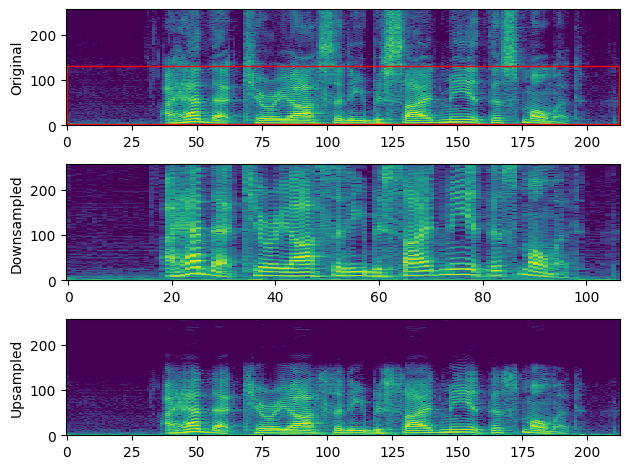

- 위의 시각화에서 두 번째 플롯("다운샘플링된")은 스펙트로그램이 늘어진 것처럼 보일 수 있지만, 이는 주파수 구간차원의 의미가 원래의 그것과 다르기 때문
- 동일한 수의 빈을 가지고 있지만 두 번째 플롯에서는 주파수가 원래 샘플링 속도의 절반까지만 적용
- 다운샘플링된 신호를 다시 리샘플링하여 원본과 동일한 샘플 속도를 가지도록 하면 이 점이 더 명확해짐

## GriffinLim

- 스펙트로그램에서 파형을 복구하려면 `torchaudio.transforms.GriffinLim`을 사용
- 스펙트로그램에 사용된 것과 동일한 파라미터들을 사용해야 함

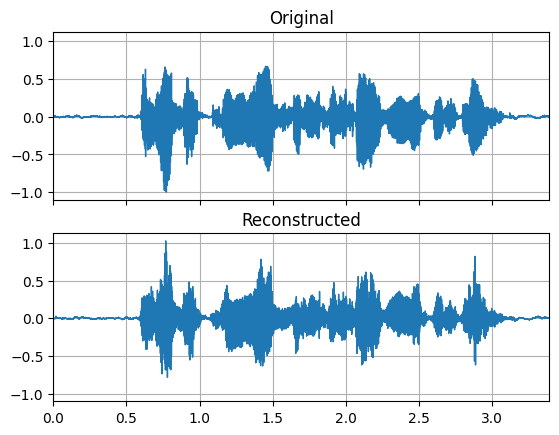

## 멜 필터 뱅크 (Mel Filter Bank)

- 이 함수는 주파수 구간을 멜 스케일 구간으로 변환하기 위한 필터 뱅크를 생성
- 이 함수에는 입력 오디오/기능이 필요하지 않으므로, `torchaudio.transforms`에 해당하는 변환이 없음

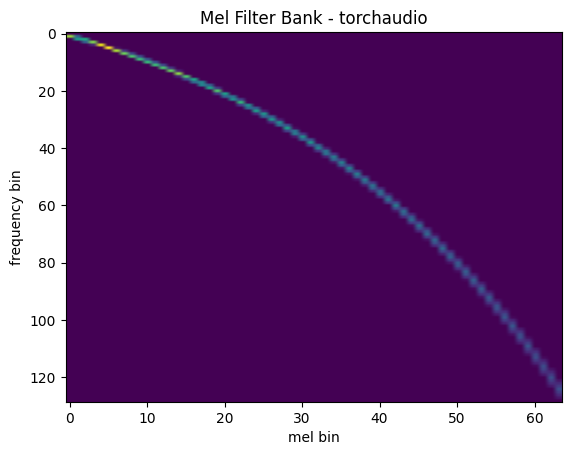

### librosa와 비교

``librosa``와 동일한 방법으로 멜 필터 뱅크를 가져오는 방법




Mean Square Difference:  3.934872696751886e-17


<ipython-input-105-3849bb4ae5ef>:3: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  mse = torch.square(mel_filters - mel_filters_librosa).mean().item()


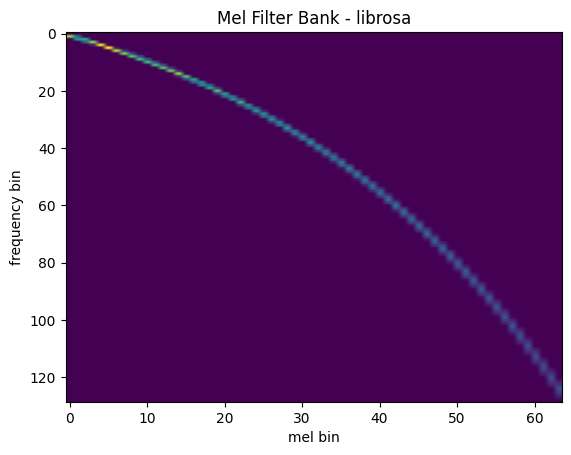

## 멜스펙트로그램 (MelSpectrogram)

- 멜 스케일 스펙트로그램을 생성하려면 스펙트로그램을 생성하고 멜 스케일 변환을 수행
- `torchaudio`에서는 `torchaudio.transforms.MelSpectrogram`에서 기능 제공

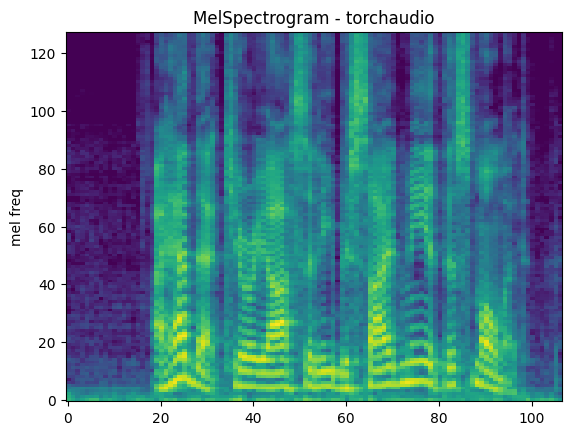

### `librosa`와 비교

``librosa``를 사용하여 멜 스케일 스펙트로그램을 생성하는 동일한 방법




Mean Square Difference:  1.2873604404717298e-09


<ipython-input-109-e4e2bf144b53>:3: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  mse = torch.square(melspec - melspec_librosa).mean().item()


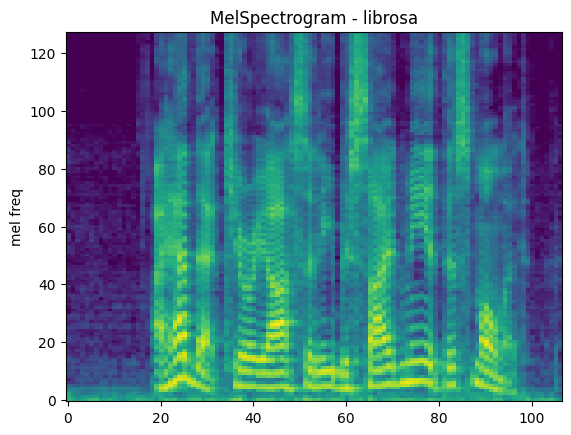

## MFCC(Mel-Frequency Cepstral Coefficient)




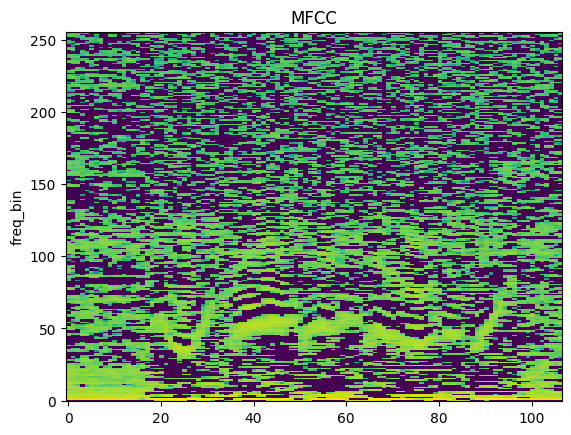

### `librosa`와 비교




Mean Square Difference:  0.8103962540626526


<ipython-input-113-6de5b2834aa3>:3: DeprecationWarning: __array_wrap__ must accept context and return_scalar arguments (positionally) in the future. (Deprecated NumPy 2.0)
  mse = torch.square(mfcc - mfcc_librosa).mean().item()


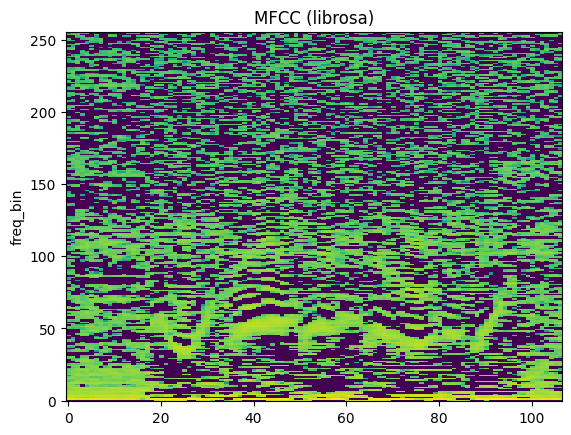

## LFCC (Linear Frequency Cepstral Coefficients)




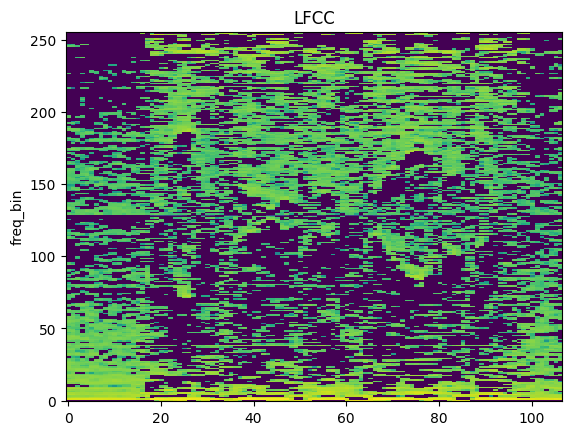

## Pitch




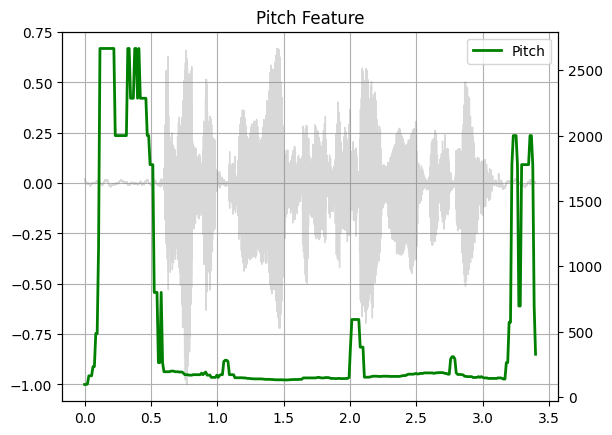

# 음성 명령 분류 (Speech Command Classification)

- 오디오 데이터 세트를 올바르게 포맷한 다음 데이터 세트에서 오디오 분류기 네트워크를 훈련/테스트
- GPU 사용을 위해 "런타임 유형 변경" (런타임이 자동으로 다시 시작되어 지금까지 실행된 셀의 정보가 사라짐)

- CUDA GPU를 사용할 수 있는지 확인 후 장치 선택
- GPU에서 실행하면 학습/테스트 런타임이 크게 단축

cuda


## 데이터 세트(Dataset)

- 데이터 세트를 다운로드하고 표현하기 위해 `torchaudio` 사용
- 여러 사람이 말한 35개의 명령어 데이터 세트인 [SPEECHCOMMANDS](https://arxiv.org/abs/1804.03209)를 사용
- SPEECHCOMMANDS 데이터 세트는 `torch.utils.data.Dataset` 버전의 데이터 세트
- 이 데이터 세트에서 모든 오디오 파일은 약 1초 길이(따라서 약 16000개의 시간 프레임 길이)
- 실제 로딩 및 포맷 단계는 데이터 포인트에 액세스할 때 발생하며, 오디오 파일을 텐서로 변환하는 작업은 `torchaudio`가 처리
- 대신 오디오 파일을 직접 로드하려는 경우, `torchaudio.load()`를 사용할 수 있고, 이 함수는 새로 생성된 텐서와 오디오 파일의 샘플링 주파수를 포함하는 튜플을 반환(SPEECHCOMMANDS의 경우 16kHz)

- 데이터 세트를 학습, 검증, 테스트 서브셋으로 분할하는 서브클래스를 생성

100%|██████████| 2.26G/2.26G [01:45<00:00, 22.9MB/s]


- SPEECHCOMMANDS 데이터 세트의 데이터 포인트는 파형(오디오 신호), 샘플 속도, 발화(레이블), 화자 ID, 발화 번호로 구성된 튜플

Shape of waveform: torch.Size([1, 16000])
Sample rate of waveform: 16000


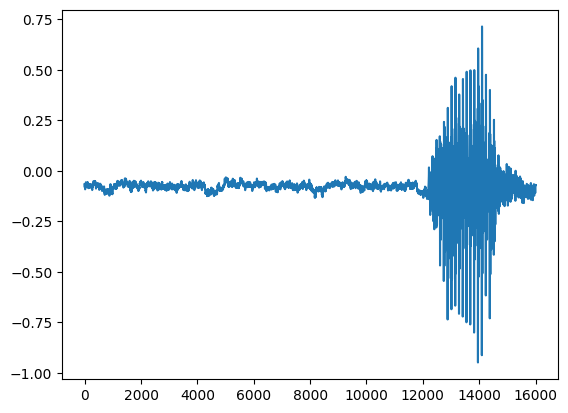

- 데이터 세트에서 사용 가능한 레이블 목록

['backward',
 'bed',
 'bird',
 'cat',
 'dog',
 'down',
 'eight',
 'five',
 'follow',
 'forward',
 'four',
 'go',
 'happy',
 'house',
 'learn',
 'left',
 'marvin',
 'nine',
 'no',
 'off',
 'on',
 'one',
 'right',
 'seven',
 'sheila',
 'six',
 'stop',
 'three',
 'tree',
 'two',
 'up',
 'visual',
 'wow',
 'yes',
 'zero']

- 35개의 오디오 레이블은 사용자가 말하는 명령어

## 데이터 서식 지정

- 파형의 경우 분류 성능을 너무 많이 잃지 않고 더 빠르게 처리하기 위해 오디오를 다운샘플링
- 여기서는 다른 변환을 적용할 필요가 없지만, 일부 데이터 세트의 경우 채널 차원을 따라 평균을 구하거나 채널 중 하나만 유지하여 채널 수를 줄여야 하는 경우가 많음(예: 스테레오에서 모노로)
- `SpeechCommands`는 오디오에 단일 채널을 사용하므로 여기서는 필요하지 않음

- 레이블 목록의 인덱스를 사용하여 각 단어를 인코딩

yes --> tensor(33) --> yes


- 오디오 녹음과 발화로 구성된 데이터 포인트 목록을 모델을 위한 두 개의 배치 텐서로 바꾸기 위해, 데이터 집합을 배치별로 반복할 수 있는 PyTorch DataLoader에서 사용하는 콜레이트 함수를 구현
- 콜레이트 함수 작업에 대한 자세한 내용은 [문서](https://pytorch.org/docs/stable/data.html#working-with-collate-fn) 참조
- 콜레이트 함수에서는 리샘플링과 텍스트 인코딩도 적용

## 모델 정의

- 원시 오디오 데이터를 처리하기 위해 컨볼루션 신경망을 사용
- 일반적으로 오디오 데이터에는 고급 변환이 적용되지만, 원시 데이터를 정확하게 처리하기 위해 CNN을 사용할 수도 있음
- M5 모델 아키텍처를 모델로 사용
- 원시 오디오 데이터를 처리하는 모델에서 중요한 측면은 첫 번째 레이어 필터의 수신 필드
- 이 모델의 첫 번째 필터는 길이가 80이므로 8kHz에서 샘플링된 오디오를 처리할 때 수신 필드는 약 10ms(4kHz에서는 약 20ms)
- 이 크기는 20ms에서 40ms 범위의 수신 필드를 사용하는 음성 처리 애플리케이션과 유사

M5(
  (conv1): Conv1d(1, 32, kernel_size=(80,), stride=(16,))
  (bn1): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool1): MaxPool1d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  (conv2): Conv1d(32, 32, kernel_size=(3,), stride=(1,))
  (bn2): BatchNorm1d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool2): MaxPool1d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  (conv3): Conv1d(32, 64, kernel_size=(3,), stride=(1,))
  (bn3): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool3): MaxPool1d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  (conv4): Conv1d(64, 64, kernel_size=(3,), stride=(1,))
  (bn4): BatchNorm1d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (pool4): MaxPool1d(kernel_size=4, stride=4, padding=0, dilation=1, ceil_mode=False)
  (fc1): Linear(in_features=64, out_features=35, bias=True)
)
Numbe

- 논문에서 사용한 것과 동일한 최적화 기법, 즉 가중치 감쇠(`weight_decay`)가 0.0001로 설정된 Adam 옵티마이저를 사용
- 처음에는 0.01의 학습률로 훈련하지만, 20번 에폭(epoch) 후에는 스케줄러를 사용하여 0.001로 낮출 것

## 모델 학습 및 평가

- 학습 데이터를 모델에 공급하고 backward pass 및 최적화 단계를 수행할 학습 함수를 정의
- 훈련에 사용할 손실은 음의 로그 확률(negative log-likelihood)
- 각 에포크 후에 모델을 테스트하여 훈련 중에 정확도가 어떻게 변하는지를 확인

- 학습 함수를 통해 모델의 정확도를 테스트하기 위한 함수 생성
- 모델을 `eval()` 모드로 설정한 다음 테스트 데이터 세트에서 추론을 실행
- `eval()`을 호출하면, 모델의 모든 모듈에서 훈련 변수가 false로 설정
- 배치 정규화 및 드롭아웃 레이어와 같은 특정 레이어는 훈련 중에 다르게 작동하므로 이 단계는 올바른 결과를 얻기 위해 매우 중요

- 모델을 훈련하고 테스트
- 10개의 에폭 동안 모델을 훈련한 다음 학습 속도를 낮추고 10개의 에폭을 더 훈련
- 각 에폭이 끝날 때마다 모델을 테스트하여 훈련 중 정확도가 어떻게 변하는지를 확인

  0%|          | 0.0026666666666666666/2 [00:02<31:38, 950.76s/it]

Train Epoch: 1 [0/84843 (0%)]	Loss: 3.715461


  3%|▎         | 0.05599999999999999/2 [00:20<11:29, 354.86s/it]

Train Epoch: 1 [5120/84843 (6%)]	Loss: 3.124635


  5%|▌         | 0.10933333333333328/2 [00:38<10:02, 318.58s/it]

Train Epoch: 1 [10240/84843 (12%)]	Loss: 2.619455


  8%|▊         | 0.16266666666666676/2 [00:56<11:42, 382.43s/it]

Train Epoch: 1 [15360/84843 (18%)]	Loss: 2.360669


 11%|█         | 0.21600000000000033/2 [01:14<09:39, 325.01s/it]

Train Epoch: 1 [20480/84843 (24%)]	Loss: 2.100652


 13%|█▎        | 0.2693333333333337/2 [01:32<10:54, 378.01s/it] 

Train Epoch: 1 [25600/84843 (30%)]	Loss: 1.925460


 16%|█▌        | 0.3226666666666667/2 [01:50<08:57, 320.65s/it] 

Train Epoch: 1 [30720/84843 (36%)]	Loss: 1.861993


 19%|█▉        | 0.3759999999999997/2 [02:07<08:24, 310.58s/it]

Train Epoch: 1 [35840/84843 (42%)]	Loss: 1.640308


 21%|██▏       | 0.42933333333333273/2 [02:25<08:36, 329.01s/it]

Train Epoch: 1 [40960/84843 (48%)]	Loss: 1.547947


 24%|██▍       | 0.48266666666666574/2 [02:43<07:52, 311.34s/it]

Train Epoch: 1 [46080/84843 (54%)]	Loss: 1.280042


 27%|██▋       | 0.5359999999999995/2 [03:01<08:23, 343.69s/it]

Train Epoch: 1 [51200/84843 (60%)]	Loss: 1.448409


 29%|██▉       | 0.5893333333333336/2 [03:18<07:24, 315.17s/it]

Train Epoch: 1 [56320/84843 (66%)]	Loss: 1.265486


 32%|███▏      | 0.6426666666666677/2 [03:37<08:12, 362.97s/it]

Train Epoch: 1 [61440/84843 (72%)]	Loss: 1.114384


 35%|███▍      | 0.6960000000000018/2 [03:54<06:52, 316.43s/it]

Train Epoch: 1 [66560/84843 (78%)]	Loss: 1.229348


 37%|███▋      | 0.749333333333336/2 [04:12<08:05, 388.02s/it] 

Train Epoch: 1 [71680/84843 (84%)]	Loss: 1.294459


 40%|████      | 0.8026666666666701/2 [04:30<06:20, 317.48s/it]

Train Epoch: 1 [76800/84843 (90%)]	Loss: 1.133586


 43%|████▎     | 0.8560000000000042/2 [04:48<06:45, 354.27s/it]

Train Epoch: 1 [81920/84843 (96%)]	Loss: 1.102878


 50%|█████     | 1.0000000000000062/2 [05:35<05:10, 310.82s/it]


Test Epoch: 1	Accuracy: 6857/11005 (62%)



 50%|█████     | 1.0026666666666728/2 [05:36<05:10, 311.59s/it]

Train Epoch: 2 [0/84843 (0%)]	Loss: 0.950911


 53%|█████▎    | 1.0560000000000047/2 [05:54<05:09, 327.58s/it]

Train Epoch: 2 [5120/84843 (6%)]	Loss: 0.960819


 55%|█████▌    | 1.1093333333333366/2 [06:11<04:40, 314.56s/it]

Train Epoch: 2 [10240/84843 (12%)]	Loss: 1.027031


 58%|█████▊    | 1.1626666666666685/2 [06:30<04:44, 339.56s/it]

Train Epoch: 2 [15360/84843 (18%)]	Loss: 1.055163


 61%|██████    | 1.2160000000000004/2 [06:47<04:06, 314.04s/it]

Train Epoch: 2 [20480/84843 (24%)]	Loss: 1.028776


 63%|██████▎   | 1.2693333333333323/2 [07:05<04:21, 358.39s/it]

Train Epoch: 2 [25600/84843 (30%)]	Loss: 0.873384


 66%|██████▌   | 1.3226666666666642/2 [07:23<03:33, 314.63s/it]

Train Epoch: 2 [30720/84843 (36%)]	Loss: 0.967335


 69%|██████▉   | 1.3759999999999961/2 [07:41<04:05, 392.73s/it]

Train Epoch: 2 [35840/84843 (42%)]	Loss: 0.872337


 71%|███████▏  | 1.429333333333328/2 [07:59<03:03, 320.73s/it] 

Train Epoch: 2 [40960/84843 (48%)]	Loss: 0.883590


 74%|███████▍  | 1.48266666666666/2 [08:16<03:02, 352.03s/it]  

Train Epoch: 2 [46080/84843 (54%)]	Loss: 0.856301


 77%|███████▋  | 1.5359999999999918/2 [08:34<02:29, 322.59s/it]

Train Epoch: 2 [51200/84843 (60%)]	Loss: 0.946583


 79%|███████▉  | 1.5893333333333237/2 [08:52<02:07, 311.21s/it]

Train Epoch: 2 [56320/84843 (66%)]	Loss: 0.869451


 82%|████████▏ | 1.6426666666666556/2 [09:10<02:00, 336.20s/it]

Train Epoch: 2 [61440/84843 (72%)]	Loss: 0.887346


 85%|████████▍ | 1.6959999999999875/2 [09:27<01:34, 311.02s/it]

Train Epoch: 2 [66560/84843 (78%)]	Loss: 1.033756


 87%|████████▋ | 1.7493333333333194/2 [09:46<01:27, 350.04s/it]

Train Epoch: 2 [71680/84843 (84%)]	Loss: 0.834290


 90%|█████████ | 1.8026666666666513/2 [10:03<01:02, 316.01s/it]

Train Epoch: 2 [76800/84843 (90%)]	Loss: 0.794210


 93%|█████████▎| 1.8559999999999832/2 [10:22<00:52, 367.12s/it]

Train Epoch: 2 [81920/84843 (96%)]	Loss: 1.010225


100%|█████████▉| 1.9999999999999793/2 [11:08<00:00, 334.50s/it]


Test Epoch: 2	Accuracy: 7954/11005 (72%)



- 모델은 테스트 세트에서 2 에폭 후 65% 이상, 21 에포크 후 85% 이상의 정확도를 보여야 함
- 학습 세트의 마지막 단어를 살펴보고 모델이 어떻게 수행했는지 살펴봄

Expected: zero. Predicted: zero.


- 올바르게 분류되지 않은 예가 있다면 찾아보기

Data point #1. Expected: right. Predicted: three.


- 레이블 중 하나를 사용해 직접 녹음
- 아래 셀을 실행하면서 "Go"라고 말하여 녹음
- 1초 분량의 오디오가 녹음되고 분류를 시도

Recording started for 1 seconds.


<IPython.core.display.Javascript object>

Recording ended.
Predicted: up.


## 결론

- `torchaudio`를 사용해 데이터 세트를 로드하고 신호를 리샘플링
- 주어진 명령을 인식하도록 훈련한 신경망을 정의
- 데이터 세트의 크기를 줄일 수 있는 멜 주파수 세프스트랄 계수(MFCC) 찾기와 같은 다른 데이터 전처리 방법도 있고, 이 변환은 `torchaudio`에서 `torchaudio.transforms.MFCC`로 사용 가능

# 음성 인식 (Speech Recognition) with Wav2Vec2

- Wav2vec 2.0([paper](https://arxiv.org/abs/2006.11477))으로 사전 학습된 모델을 사용하여 음성 인식 수행

## 음성 인식 과정

1. 오디오 파형에서 음향 특징 추출
2. 프레임 별로 음향 특징의 클래스 추정
3. 클래스 확률 시퀀스에서 가설 생성

- Torchaudio는 사전 학습된 가중치와 예상 샘플 속도 및 클래스 레이블과 같은 관련 정보에 쉽게 액세스할 수 있도록 지원, `torchaudio.pipelines` 모듈에서 사용 가능

## 라이브러리 및 데이터 준비




2.6.0+cu124
2.6.0+cu124
cuda


## 파이프라인 생성

- 특징 추출과 분류를 수행하는 Wav2Vec2 모델을 생성
- `torchaudio`에는 두 가지 유형의 Wav2Vec2 사전 훈련된 가중치가 있음
- ASR 작업에 맞게 미세 조정된 것과 미세 조정되지 않은 것
- Wav2Vec2(및 HuBERT) 모델은 자기 지도 방식으로 훈련
- 먼저 표현 학습을 위해 오디오로만 학습한 다음, 추가 레이블을 사용하여 특정 작업에 맞게 미세 조정
- 미세 조정 없이 사전 학습된 가중치는 다른 다운스트림 작업에서도 미세 조정할 수 있지만, 여기서는 다루지 않음
- 여기서는 `torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H` 사용
- 미리 학습된 모델은 `torchaudio.pipelines`에서 여러 개 사용 가능
- 번들 객체는 모델 및 기타 정보를 인스턴스화하기 위한 인터페이스를 제공

Sample Rate: 16000
Labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


- 모델은 다음과 같이 구성할 수 있고, 이 프로세스는 미리 학습된 가중치를 자동으로 가져와서 모델에 로드

Downloading: "https://download.pytorch.org/torchaudio/models/wav2vec2_fairseq_base_ls960_asr_ls960.pth" to /root/.cache/torch/hub/checkpoints/wav2vec2_fairseq_base_ls960_asr_ls960.pth
100%|██████████| 360M/360M [00:05<00:00, 63.3MB/s]


<class 'torchaudio.models.wav2vec2.model.Wav2Vec2Model'>


## 데이터 로드

- VOiCES 데이터셋의 음성 데이터 사용

- 데이터를 로드하려면 `torchaudio.load`를 사용
- 샘플링 속도가 파이프라인이 예상하는 것과 다르면 `torchaudio.functional.resample`을 사용하여 리샘플링 수행, `torchaudio.functional.resample`은 CUDA 텐서에서도 작동
- 동일한 샘플 레이트 세트에서 리샘플링을 여러 번 수행할 때 `torchaudio.transforms.Resample`을 사용하면 성능이 향상

## 음향 특징 추출

- 오디오에서 음향 특징을 추출
- ASR 작업에 맞게 미세 조정된 Wav2Vec2 모델은 한 단계로 특징 추출과 분류를 수행할 수 있지만, 여기서는 특징 추출하는 방법도 수행

- 반환된 특징은 텐서 목록, 각 텐서는 트랜스포머 레이어의 출력

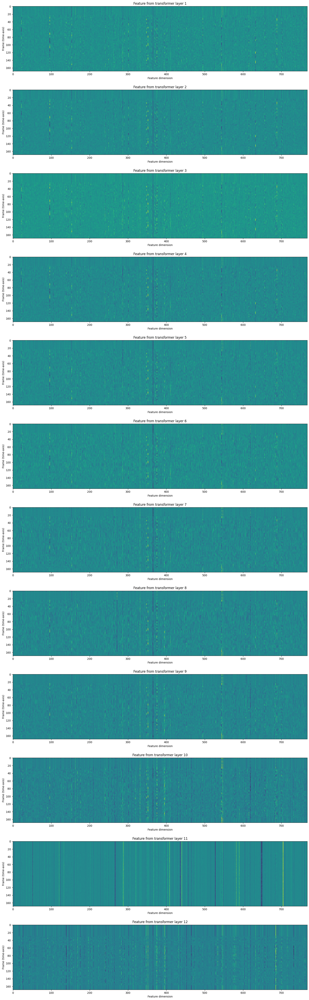

## 특징 분류 (Feature classification)

- 음향 특징이 추출되면 다음 단계로 일련의 카테고리로 분류
- Wav2Vec2 모델은 특징 추출과 분류를 한 번에 수행할 수 있는 방법 제공

- 출력은 로그 형식으로 확률의 형태가 아님

Class labels: ('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


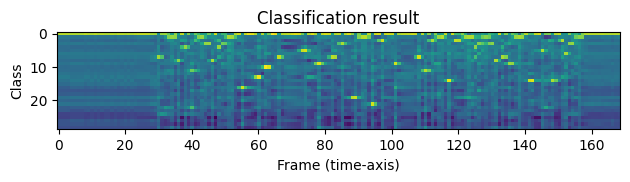

- 시간대별로 특정 레이블에 대한 강력한 징후가 있음을 알 수 있음

## Generating transcripts

- 일련의 레이블 확률에서 트랜스크립트를 생성
- 가설을 생성하는 과정을 흔히 "디코딩"이라고 함
- 특정 시간 단계에서의 디코딩은 주변 관찰에 영향을 받을 수 있기 때문에 디코딩은 단순한 분류보다 더 정교함
- 예를 들어, `night`과 `knight`와 같은 단어를 예로 들어보면, 두 단어의 사전 확률 분포가 다르더라도(일반적인 대화에서는 `night`이 `knight`보다 훨씬 더 자주 등장)
- `a knight with a sword`와 같이 `knight`가 포함된 transcripts를 정확하게 생성하려면 디코딩 프로세스는 충분한 문맥을 확인할 때까지 최종 결정을 연기해야 함
- 많은 디코딩 기술이 제안되어 있으며 단어 사전이나 언어 모델과 같은 외부 리소스가 필요
- 여기서는 단순화를 위해 이러한 외부 요소에 의존하지 않고 각 시간 단계에서 최적의 가설을 선택하는 greedy 디코딩만 수행
- 문맥 정보는 사용되지 않으며 하나의 transcripts만 생성 가능
- 먼저 greedy 디코딩 알고리즘을 정의

- 디코더 객체를 생성하고 transcripts를 디코딩

- 결과를 확인하고 오디오로 들어보기

I|HAD|THAT|CURIOSITY|BESIDE|ME|AT|THIS|MOMENT|


- ASR 모델은 Connectionist Temporal Classification (CTC)라는 손실 함수를 사용하여 미세 조정
- CTC loss에 대한 자세한 설명은 [여기](https://distill.pub/2017/ctc/)에서 확인
- CTC에서 빈 토큰(ϵ)은 이전 기호의 반복을 나타내는 특수 토큰으로 디코딩 시에는 단순히 무시

## 결론

- 음향 특징 추출 및 음성 인식을 수행하기 위해 `torchaudio.pipelines.Wav2Vec2ASRBundle`을 사용하는 방법을 살펴봄
- 모델을 구성하고 결과를 얻는 것은 두 줄 정도로 짧음

# Wav2Vec2로 강제 정렬

- CTC-Segmentation 알고리즘을 사용하여 `torchaudio`로 대본을 음성으로 정렬하는 방법
- Wav2Vec2 사전 학습 모델의 사용 사례를 설명하기 위해 작성
- TorchAudio에는 강제 정렬용으로 설계된 API 집합이 있고, CTC 강제 정렬 API 에서는 핵심 API인 `torchaudio.functional.forced_align`의 사용법을 설명
- 코퍼스를 정렬하려는 경우, 강제 정렬을 위해 특별히 훈련된 사전 훈련 모델과 `torchaudio.functional.forced_align` 및 기타 지원 기능을 결합한 `torchaudio.pipelines.Wav2Vec2FABundle`을 사용하는 것을 권장

2.6.0+cu124
2.6.0+cu124
cuda


## 음성 인식 과정

1. 오디오 파형에서 프레임별 라벨 확률 추정 시간 단계에서 정렬된 라벨의 확률을 나타내는 격자 행렬을 생성
- 격자 행렬에서 가장 가능성이 높은 경로를 찾음
- 여기서는 음향 특징 추출을 위해 `torchaudio`의 `Wav2Vec2` 모델 사용

## 라이브러리 및 데이터 준비

필요한 패키지를 가져오고 작업할 데이터로 로드

## 프레임별 레이블 확률 생성

- 첫 번째 단계는 각 오디오 프레임의 레이블 클래스 포비블을 생성하는 것
- ASR용으로 훈련된 Wav2Vec2 모델을 사용할 수 있음
- `torchaudio.pipelines.WAV2VEC2_ASR_BASE_960H`를 사용
- `torchaudio`는 관련 레이블이 있는 사전 학습된 모델에 쉽게 액세스할 수 있음
- 다음은 수치 불안정을 피하기 위해 로그 도메인으로 확률을 계산, 이를 위해 ``emission``을 `torch.log_softmax`로 정규화

('-', '|', 'E', 'T', 'A', 'O', 'N', 'I', 'H', 'S', 'R', 'D', 'L', 'U', 'M', 'W', 'C', 'F', 'G', 'Y', 'P', 'B', 'V', 'K', "'", 'X', 'J', 'Q', 'Z')


### 시각화 (Visualization)



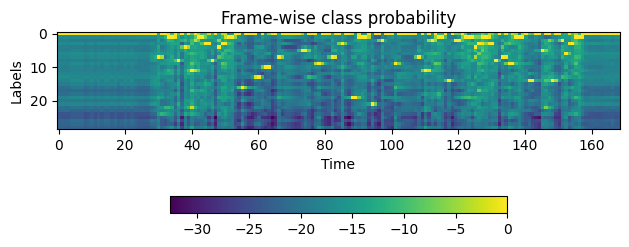

## 정렬 확률 생성(격자)

- 방출 행렬(emission matrix)에서 다음으로 각 시간 프레임에서 transcript 레이블이 발생할 확률을 나타내는 격자 생성
- 격자는 시간 축과 레이블 축이 있는 2D 행렬
- 레이블 축은 정렬하려는 트랜스크립트를 나타냄
- 아래에서는 시간 축의 인덱스를 나타내기 위해 $t$를 사용하고 라벨 축의 인덱스를 나타내기 위해 $j$를 사용
- $c_j$는 라벨 인덱스 $j$의 라벨을 나타냄
- 시간 단계 $t+1$의 확률을 생성하려면, 시간 단계 $t$의 격자와 시간 단계 $t+1$의 방출을 살펴봄
- 레이블 $c_{j+1}$을 가진 시간 단계 $t+1$에 도달하는 경로에는 두 가지가 존재
  - 첫 번째는 $t$에서 레이블이 $c_{j+1}$이고 $t$에서 $t+1$로 레이블이 변경되지 않은 경우
  - 다른 경우는 $t$에서 레이블이 $c_j$였고 $t+1$에서 다음 레이블인 $c_{j+1}$로 전환된 경우

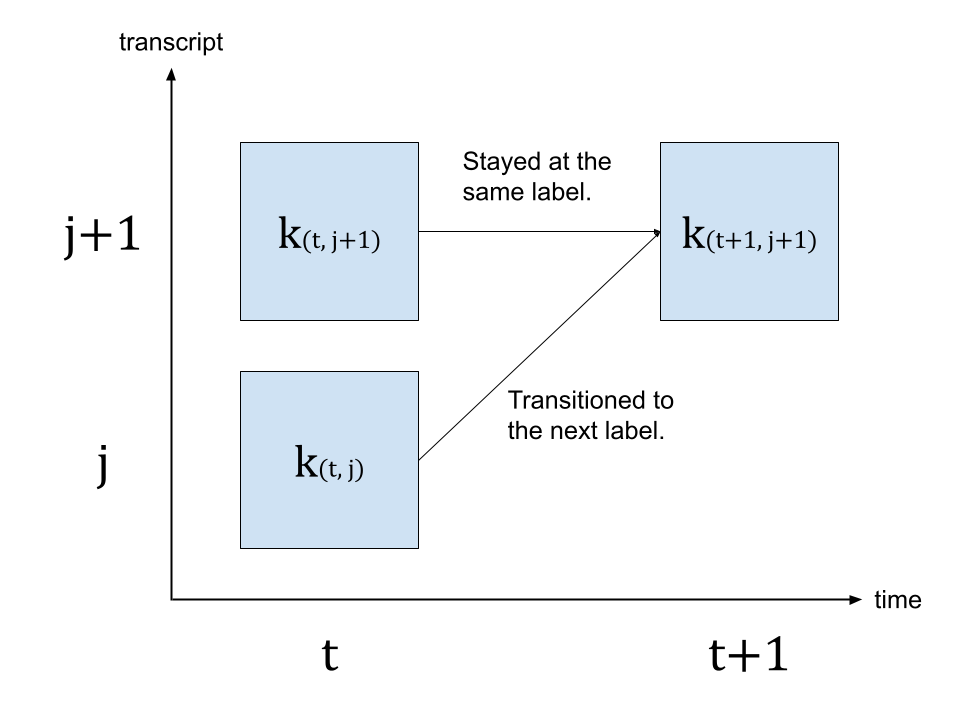

- 가장 가능성이 높은 전환을 찾고 있으므로, $k_{(t+1,j+1)}$ 값에 대해 더 가능성이 높은 경로

$$ k_{(t+1, j+1)} = max( k_{(t, j)} p(t+1, c_{j+1}), k_{(t, j+1)} p(t+1, repeat) ) $$

- 여기서 $k$는 격자 행렬을 나타내고, $p(t,c_j)$는 시간 단계 $t$에서 라벨 $c_j$의 확률을 나타냄
- 반복은 CTC 공식의 빈 토큰을 나타냄 (CTC 알고리즘에 대한 자세한 내용은 *Sequence Modeling with CTC* [distill.pub](https://distill.pub/2017/ctc/)) 참고

[('|', 1), ('I', 7), ('|', 1), ('H', 8), ('A', 4), ('D', 11), ('|', 1), ('T', 3), ('H', 8), ('A', 4), ('T', 3), ('|', 1), ('C', 16), ('U', 13), ('R', 10), ('I', 7), ('O', 5), ('S', 9), ('I', 7), ('T', 3), ('Y', 19), ('|', 1), ('B', 21), ('E', 2), ('S', 9), ('I', 7), ('D', 11), ('E', 2), ('|', 1), ('M', 14), ('E', 2), ('|', 1), ('A', 4), ('T', 3), ('|', 1), ('T', 3), ('H', 8), ('I', 7), ('S', 9), ('|', 1), ('M', 14), ('O', 5), ('M', 14), ('E', 2), ('N', 6), ('T', 3), ('|', 1)]


### 시각화 (Visualization)



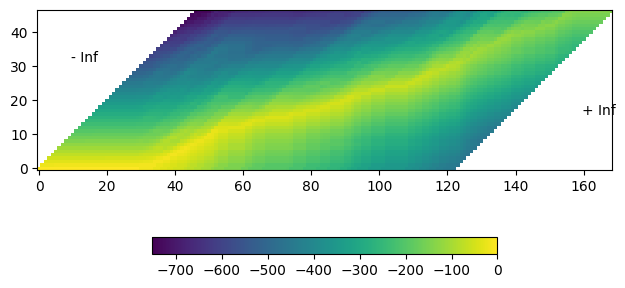

- 위의 시각화에서 행렬을 대각선으로 가로지르는 높은 확률의 흔적이 있는 것을 볼 수 있음

## 가장 가능성이 높은 경로 찾기(역추적)

- 격자가 생성되면 확률이 높은 요소를 따라 격자를 순회
- 확률이 가장 높은 시간 단계의 마지막 레이블 인덱스에서 시작
- 시간을 거슬러 올라가서 전이 후 확률인 $k_{t, j} p(t+1, c_{j+1})$ 또는 $k_{t, j+1} p(t+1, repeat)$를 기준으로 체류 ($c_j \rightarrow c_j$) 또는 전환 ($c_j \rightarrow c_{j+1}$)을 선택해 경로를 추적
- 라벨이 처음에 도달하면 전이가 수행
- 경로 탐색에는 격자 행렬이 사용되지만 각 세그먼트의 최종 확률은 방출 행렬에서 프레임별 확률을 취함

Point(token_index=0, time_index=0, score=0.9999996423721313)
Point(token_index=0, time_index=1, score=0.9999996423721313)
Point(token_index=0, time_index=2, score=0.9999996423721313)
Point(token_index=0, time_index=3, score=0.9999996423721313)
Point(token_index=0, time_index=4, score=0.9999996423721313)
Point(token_index=0, time_index=5, score=0.9999996423721313)
Point(token_index=0, time_index=6, score=0.9999996423721313)
Point(token_index=0, time_index=7, score=0.9999996423721313)
Point(token_index=0, time_index=8, score=0.9999998807907104)
Point(token_index=0, time_index=9, score=0.9999996423721313)
Point(token_index=0, time_index=10, score=0.9999996423721313)
Point(token_index=0, time_index=11, score=0.9999998807907104)
Point(token_index=0, time_index=12, score=0.9999996423721313)
Point(token_index=0, time_index=13, score=0.9999996423721313)
Point(token_index=0, time_index=14, score=0.9999996423721313)
Point(token_index=0, time_index=15, score=0.9999996423721313)
Point(token_index=

### 시각화 (Visualization)



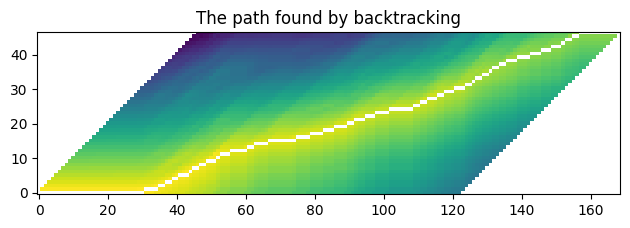

## 경로 분할

- 이 경로에는 동일한 레이블에 대한 반복이 포함되어 있으므로 원본 transcripts에 가깝도록 병합
- 여러 경로 지점을 병합할 때는 병합된 세그먼트의 평균 확률을 구하기만 하면 됨

|	(1.00): [    0,    31)
I	(0.78): [   31,    35)
|	(0.80): [   35,    37)
H	(1.00): [   37,    39)
A	(0.96): [   39,    41)
D	(0.65): [   41,    44)
|	(1.00): [   44,    45)
T	(0.55): [   45,    47)
H	(1.00): [   47,    49)
A	(0.03): [   49,    52)
T	(1.00): [   52,    53)
|	(1.00): [   53,    56)
C	(0.97): [   56,    61)
U	(1.00): [   61,    63)
R	(0.75): [   63,    67)
I	(0.88): [   67,    75)
O	(0.99): [   75,    79)
S	(1.00): [   79,    83)
I	(0.89): [   83,    86)
T	(0.78): [   86,    90)
Y	(0.70): [   90,    92)
|	(0.66): [   92,    95)
B	(1.00): [   95,    98)
E	(1.00): [   98,   102)
S	(1.00): [  102,   109)
I	(1.00): [  109,   111)
D	(0.93): [  111,   113)
E	(0.66): [  113,   116)
|	(1.00): [  116,   118)
M	(0.67): [  118,   121)
E	(0.67): [  121,   124)
|	(0.49): [  124,   126)
A	(1.00): [  126,   127)
T	(0.50): [  127,   129)
|	(0.51): [  129,   131)
T	(1.00): [  131,   132)
H	(1.00): [  132,   134)
I	(0.75): [  134,   136)
S	(0.36): [  136,   139)
|	(0.50): [  139,   143)


### 시각화 (Visualization)



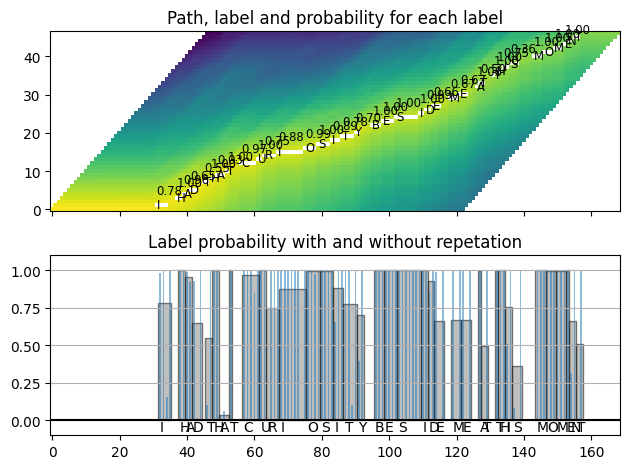

## 단어로 세그먼트 병합

- 이제 단어를 병합
- Wav2Vec2 모델은 '|'를 단어 경계로 사용하므로 '|'가 발생할 때마다 세그먼트를 병합
- 마지막으로 원본 오디오를 세그먼트화된 오디오로 분할한 후 듣고 세그먼트화가 올바른지 확인

I	(0.78): [   31,    35)
HAD	(0.84): [   37,    44)
THAT	(0.52): [   45,    53)
CURIOSITY	(0.89): [   56,    92)
BESIDE	(0.94): [   95,   116)
ME	(0.67): [  118,   124)
AT	(0.66): [  126,   129)
THIS	(0.70): [  131,   139)
MOMENT	(0.88): [  143,   157)


### 시각화 (Visualization)



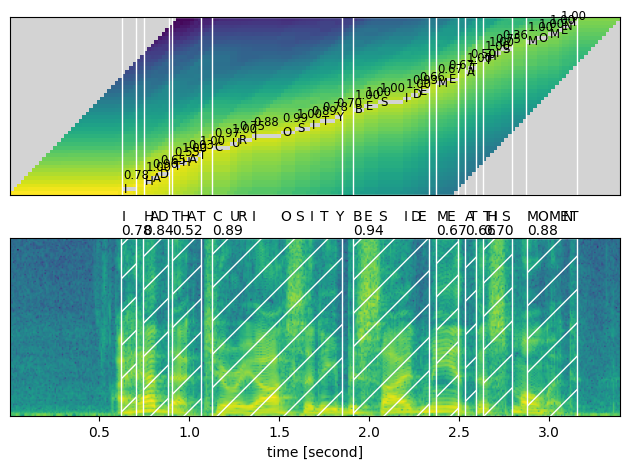

## Audio Samples




|I|HAD|THAT|CURIOSITY|BESIDE|ME|AT|THIS|MOMENT|


I (0.78): 0.624 - 0.704 sec


HAD (0.84): 0.744 - 0.885 sec


THAT (0.52): 0.905 - 1.066 sec


CURIOSITY (0.89): 1.127 - 1.851 sec


BESIDE (0.94): 1.911 - 2.334 sec


ME (0.67): 2.374 - 2.495 sec


AT (0.66): 2.535 - 2.595 sec


THIS (0.70): 2.635 - 2.796 sec


MOMENT (0.88): 2.877 - 3.159 sec


## 결론

- 강제 정렬을 위해 `torchaudio`의 Wav2Vec2 모델을 사용하여 CTC 분할을 수행하는 방법을 살펴봄


# Whisper 모델

- OpenAI가 개발한 다국어 음성 인식 모델로, 다양한 언어와 소음을 처리하는 데 강점

## Whisper 설치

Whisper 모델을 사용하고 트랜스크립션 결과를 평가하는 데 필요한 Python 패키지 설치

  Cloning https://github.com/openai/whisper.git to /tmp/pip-req-build-nsdqptgc
  Running command git clone --filter=blob:none --quiet https://github.com/openai/whisper.git /tmp/pip-req-build-nsdqptgc
  Resolved https://github.com/openai/whisper.git to commit e6a5fc0ff03b40e420f83526d20ee2d29ebff4de
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 117.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 88.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 57.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 14.9 MB/s eta 0:00:00
   ━━━

## LibriSpeech 데이터셋 로드

torchaudio를 사용하여 LibriSpeech 코퍼스의 테스트-클린 분할 로드

100%|██████████| 331M/331M [00:26<00:00, 13.3MB/s]


## 기본 Whisper 모델을 사용한 추론

데이터 세트의 모든 발화를 전사하는 데 몇 분 정도 걸림

100%|████████████████████████████████████████| 139M/139M [00:00<00:00, 146MiB/s]


Model is English-only and has 71,825,408 parameters.


  0%|          | 0/164 [00:00<?, ?it/s]

,hypothesis,reference
0,"He hoped there would be stew for dinner, turni...",HE HOPED THERE WOULD BE STEW FOR DINNER TURNIP...
1,"Stuffered into you, his belly counseled him.",STUFF IT INTO YOU HIS BELLY COUNSELLED HIM
2,After early nightfall the yellow lamps would l...,AFTER EARLY NIGHTFALL THE YELLOW LAMPS WOULD L...
3,"Hello Bertie, any good in your mind?",HELLO BERTIE ANY GOOD IN YOUR MIND
4,Number 10. Fresh Nelly is waiting on you. Good...,NUMBER TEN FRESH NELLY IS WAITING ON YOU GOOD ...
5,"The music came nearer, and he recalled the wor...",THE MUSIC CAME NEARER AND HE RECALLED THE WORD...
6,The dull light fell more faintly upon the page...,THE DULL LIGHT FELL MORE FAINTLY UPON THE PAGE...
7,"A cold, lucid indifference reigned in his soul.",A COLD LUCID INDIFFERENCE REIGNED IN HIS SOUL
8,The chaos in which his order extinguished itse...,THE CHAOS IN WHICH HIS ARDOUR EXTINGUISHED ITS...
9,"At most, by an alms given to a beggar whose bl...",AT MOST BY AN ALMS GIVEN TO A BEGGAR WHOSE BLE...


## Word Error Rate (WER) 계산

단어 오류율 계산하기 이제 영어 정규화 구현을 사용하여 표준화하고 WER을 계산

,hypothesis,reference,hypothesis_clean,reference_clean
0,"He hoped there would be stew for dinner, turni...",HE HOPED THERE WOULD BE STEW FOR DINNER TURNIP...,he hoped there would be stew for dinner turnip...,he hoped there would be stew for dinner turnip...
1,"Stuffered into you, his belly counseled him.",STUFF IT INTO YOU HIS BELLY COUNSELLED HIM,stuffered into you his belly counseled him,stuff it into you his belly counseled him
2,After early nightfall the yellow lamps would l...,AFTER EARLY NIGHTFALL THE YELLOW LAMPS WOULD L...,after early nightfall the yellow lamps would l...,after early nightfall the yellow lamps would l...
3,"Hello Bertie, any good in your mind?",HELLO BERTIE ANY GOOD IN YOUR MIND,hello bertie any good in your mind,hello bertie any good in your mind
4,Number 10. Fresh Nelly is waiting on you. Good...,NUMBER TEN FRESH NELLY IS WAITING ON YOU GOOD ...,number 10 fresh nelly is waiting on you good n...,number 10 fresh nelly is waiting on you good n...
5,"The music came nearer, and he recalled the wor...",THE MUSIC CAME NEARER AND HE RECALLED THE WORD...,the music came nearer and he recalled the word...,the music came nearer and he recalled the word...
6,The dull light fell more faintly upon the page...,THE DULL LIGHT FELL MORE FAINTLY UPON THE PAGE...,the dull light fell more faintly upon the page...,the dull light fell more faintly upon the page...
7,"A cold, lucid indifference reigned in his soul.",A COLD LUCID INDIFFERENCE REIGNED IN HIS SOUL,a cold lucid indifference reigned in his soul,a cold lucid indifference reigned in his soul
8,The chaos in which his order extinguished itse...,THE CHAOS IN WHICH HIS ARDOUR EXTINGUISHED ITS...,the chaos in which his order extinguished itse...,the chaos in which his ardor extinguished itse...
9,"At most, by an alms given to a beggar whose bl...",AT MOST BY AN ALMS GIVEN TO A BEGGAR WHOSE BLE...,at most by an alms given to a beggar whose ble...,at most by an alms given to a beggar whose ble...


WER: 4.27 %


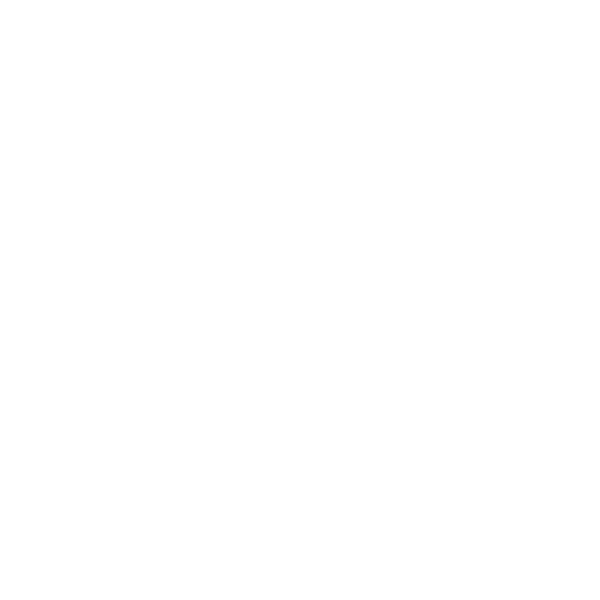

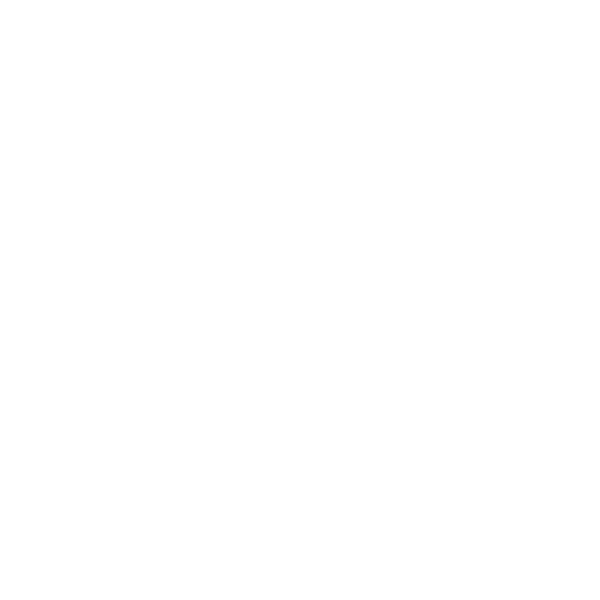

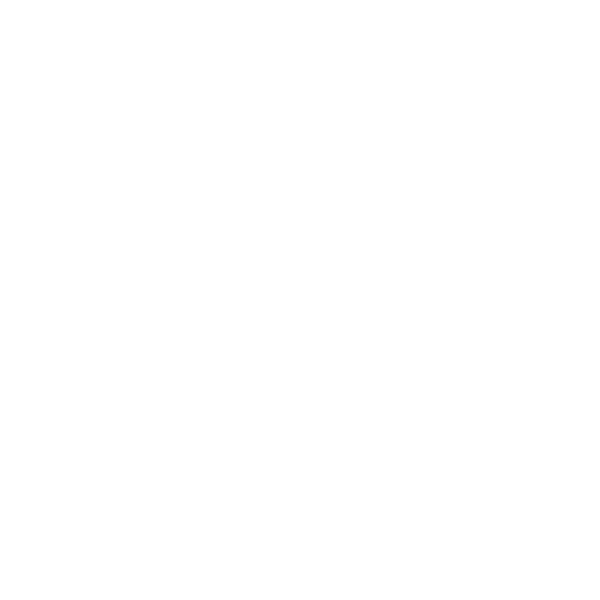

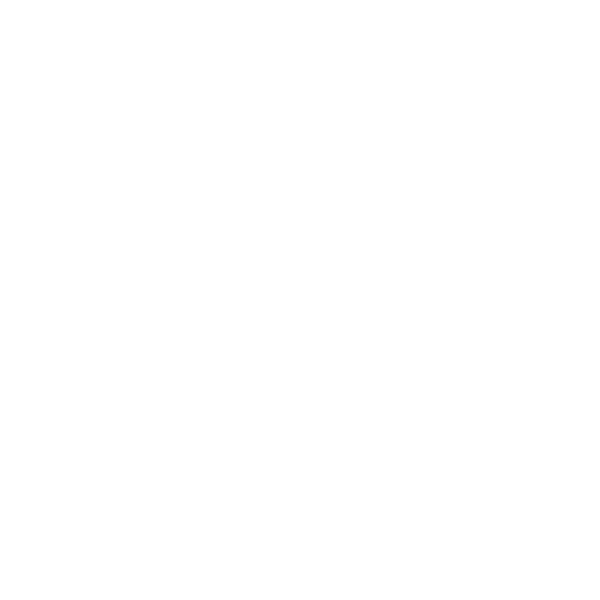

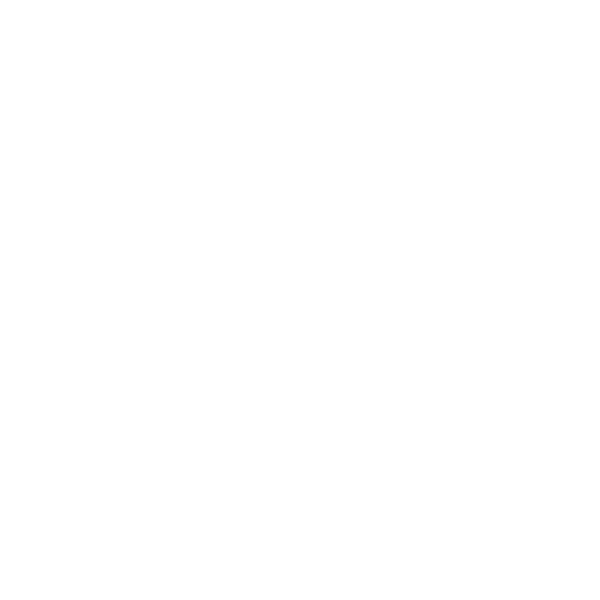

...

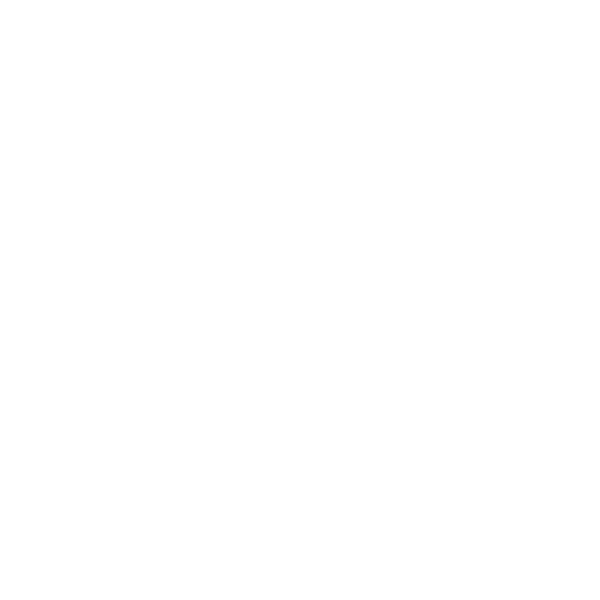

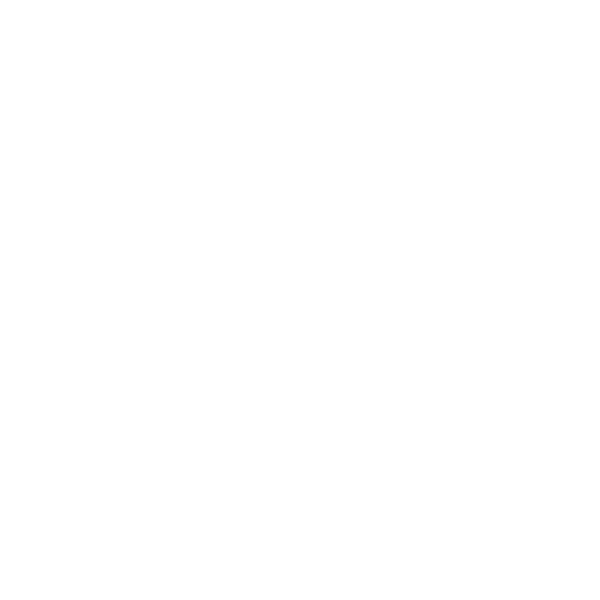

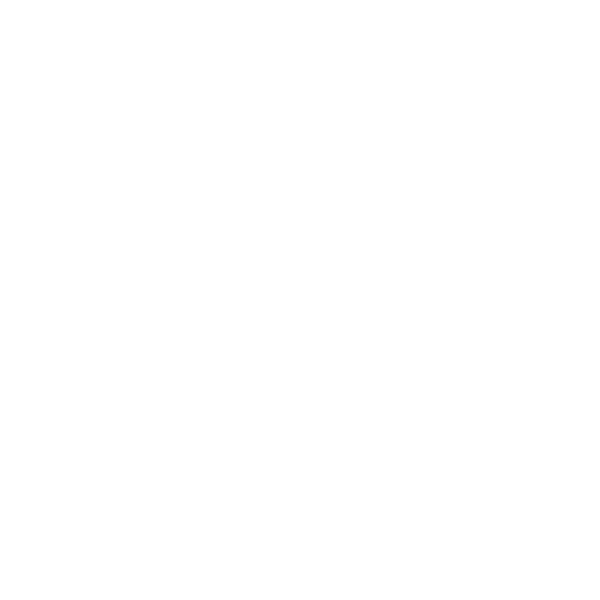

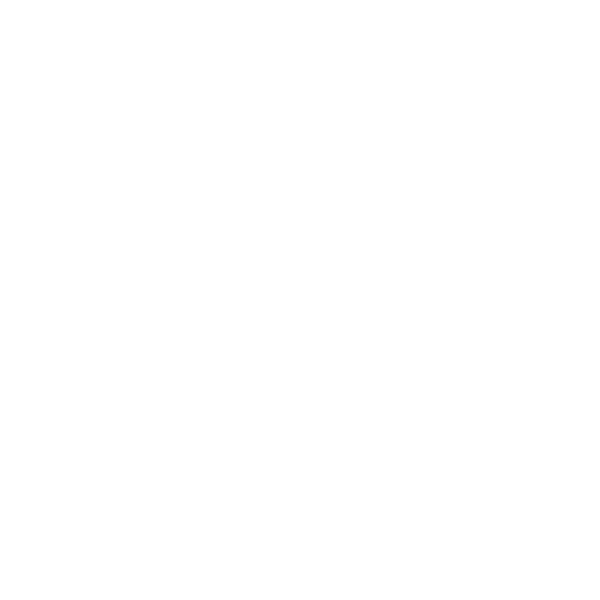

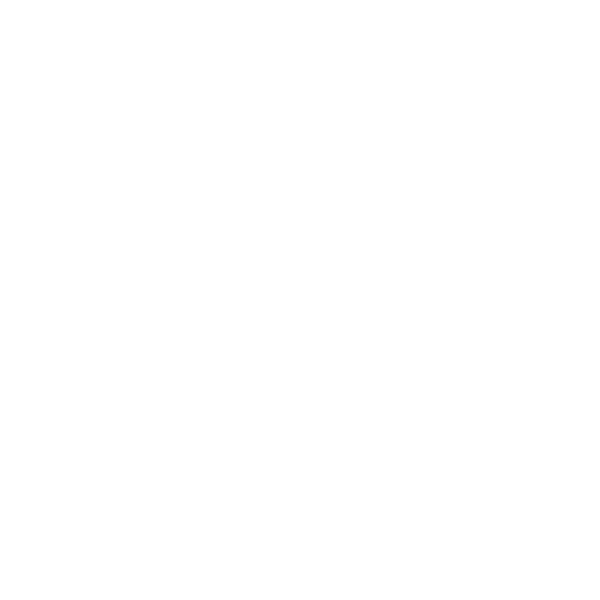